# Simple event plotting of CNN mPMT dataset

In [1]:
%load_ext autoreload
%matplotlib inline
#%matplotlib widget
%autoreload 2

In [2]:
import sys
import os
import h5py
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.collections import PatchCollection
import mpl_toolkits.mplot3d.art3d as art3d
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import Axes3D 
import torch
import copy

In [3]:
print(os.getcwd())
#sys.path.append('/home/nprouse/WatChMaL/WatChMaL_analysis/')
#sys.path.append('/home/nprouse/WatChMaL/WatChMaL_analysis/WatChMaL')
sys.path.append('/home/jgao/work/WatChMaL/')
sys.path.append('/home/jgao/work/WatChMaL_analysis/')

/project/6008045/jgao/WatChMaL_analysis/event_plotting


In [4]:
from watchmal.dataset.cnn_mpmt.cnn_mpmt_dataset import CNNmPMTDataset
from watchmal.dataset.pointnet.pointnet_dataset import PointNetDataset

In [5]:
def channel_to_position(channel):
    channel = channel % 19 
    theta = (channel<12)*2*np.pi*channel/12 + ((channel >= 12) & (channel<18))*2*np.pi*(channel-12)/6
    radius = 0.2*(channel<18)+0.2*(channel<12)
    position = [radius*np.cos(theta), radius*np.sin(theta)] # note this is [y, x] or [row, column]
    return position

In [6]:
'''
Plotting code for IWCD pure-mPMT ResNet setup

def plot_event(data, mpmt_pos, old_convention=False, title=None, style="default", cmap=plt.cm.jet):
    cmap = copy.copy(cmap)
    if style=="dark_background":
        edgecolor='0.15'
        cmap.set_bad(color='black')
    else:
        edgecolor='0.85'
        cmap.set_bad(color='white')
    data[data==0] = np.nan
    indices = np.indices(data.shape)
    channels = indices[0].flatten()
    positions = indices[1:].reshape(2,-1).astype(np.float64)
    positions += channel_to_position(channels)
    if old_convention:
        positions[1] = max(mpmt_pos[:, 1])-positions[1]
    mpmts = [Circle((pos[1], pos[0]), radius=0.47)
             for pos in mpmt_pos]
    with plt.style.context(style):
        if old_convention:
            figsize = (20,16)
        else:
            figsize = (20,12)
        fig = plt.figure(figsize=figsize)
        ax = fig.add_subplot(111)
        ax.add_collection(PatchCollection(mpmts, facecolor='none', linewidths=1, edgecolors=edgecolor))
        pmts = ax.scatter(positions[1], positions[0], c=data.flatten(), s=3, cmap=cmap)
        plt.colorbar(pmts)
    if title is not None:
        ax.set_title(title)
'''

In [28]:
def plot_event(data, pos_20, ori_20, pos_3, ori_3, max_hit_20, max_hit_3, title=None, style="default",
               cmap=plt.cm.jet):
    '''
    Plotting in 3D for pointnet because it's easier.
    Parameters:
        data:     object
        pos_20/3: 2D float array
                  Dim 1 is the PMT ID of each 20/3in PMT, Dim 2 is the xyz coordinate position of the PMT
        ori_20/3: 2D float array
                  Dim 1 is the PMT ID of each 20/3in PMT, Dim 2 is the xyz direction orientation of the PMT
        
    '''
    cmap = copy.copy(cmap)
    if style=="dark_background":
        edgecolor='0.15'
        cmap.set_bad(color='black')
    else:
        edgecolor='0.85'
        cmap.set_bad(color='white')

    # Need to separately consider plotting 20in and 3in PMTs
    # But step 1: plot all positions out
    x_20 = pos_20[:,0]
    y_20 = pos_20[:,1]
    z_20 = pos_20[:,2]
    x_3 = pos_3[:,0]
    y_3 = pos_3[:,1]
    z_3 = pos_3[:,2]
    
    # Step 2: incorperate the hit charge value into the plot (as 4th dim)
    # 20in
    hit_x_20  = data[0,:max_hit_20]
    hit_y_20  = data[1,:max_hit_20]
    hit_z_20  = data[2,:max_hit_20]
    charge_20 = data[-2,:max_hit_20]
    time_20   = data[-1,:max_hit_20]
    
    # 3in, FIXME still need to unify with the 20in scale
    hit_x_3  = data[0,:max_hit_3]
    hit_y_3  = data[1,:max_hit_3]
    hit_z_3  = data[2,:max_hit_3]
    charge_3 = data[-2,:max_hit_3]
    time_3   = data[-1,:max_hit_3]
    
    # Step 3: normalise the charge for 20in and 3in PMTs wrt the max charge recorded (not consistent between events)
    max_charge_20 = np.amax(charge_20)
    max_charge_3 = np.amax(charge_3)
    max_charge   = max_charge_20 if max_charge_20 > max_charge_3 else max_charge_3
    
    # Step 3: normalise the time for 20in and 3in PMTs wrt the max charge recorded (not consistent between events)
    max_time_20 = np.amax(time_20)
    max_time_3  = np.amax(time_3)
    max_time    = max_time_20 if max_time_20 > max_time_3 else max_time_3
    
    # Checking if there's a single hit recorded in the event, need refining
    try:
        a = 1/max_charge
    except ZeroDivisionError:
        print("No hit recorded in this event!")
    
#     data[data==0] = np.nan
#     indices = np.indices(data.shape)
#     channels = indices[0].flatten()  # [0,0,0,1,1,1,2,2,2,...] not applicable for my type of plotting
#     print("channels = ", channels)
#     positions = indices[1:].reshape(2,-1).astype(np.float64)
#     positions += channel_to_position(channels)
# 
#     mpmts = [Circle((pos[1], pos[0]), radius=0.47)for pos in mpmt_pos]
    
    with plt.style.context(style):
        figsize = (20,12)
        fig = plt.figure(figsize=figsize)
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter3D(x_20, y_20, z_20, c='gray', marker='o', s=0.1, alpha=0.1)
        ax.scatter3D(x_3, y_3, z_3, c='gray', marker='o', s=0.1, alpha=0.1)
        hits_20 = ax.scatter(hit_x_20, hit_y_20, hit_z_20, c=(time_20/max_time), s=3, cmap=cmap)
        hits_3 = ax.scatter(hit_x_3, hit_y_3, hit_z_3, c=(time_3/max_time), s=0.1, cmap=cmap)
        plt.colorbar(hits_20)
        
#         ax = fig.add_subplot(111)
#         ax.add_collection(PatchCollection(mpmts, facecolor='none', linewidths=1, edgecolors=edgecolor))
#         pmts = ax.scatter(positions[1], positions[0], c=data.flatten(), s=3, cmap=cmap)
#         plt.colorbar(pmts)
    if title is not None:
        ax.set_title(title)

## Testing with short tank data

### Loading data and plotting test event

In [7]:
dataset_short = PointNetDataset(h5file='/scratch/jgao/data/mu-_705_706_digihit.hdf5',
                                geometry_file='/scratch/jgao/data/output_folder/hybridHK.geo.npz',
                                is_distributed=False)

In [30]:
data_short = dataset_short.__getitem__(13)['data']  # already 'opened' the dictionary
print("successful")

successful


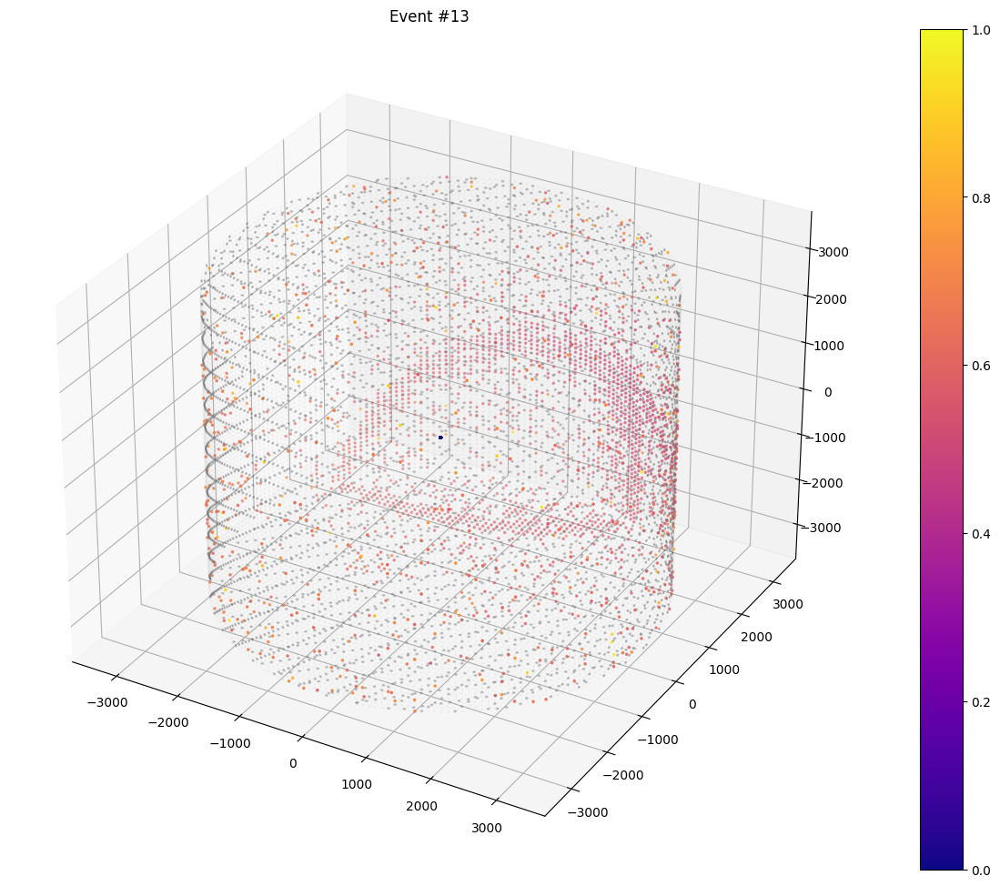

In [32]:
plot_event(data_short, dataset_short.geo_positions_20, dataset_short.geo_orientations_20,
           dataset_short.geo_positions_3, dataset_short.geo_orientations_3, dataset_short.n_points_20,
           dataset_short.n_points_3, title="Event #13", cmap=plt.cm.plasma)

### Test plots of x, y and z position values of each PMT

In [9]:
geo_file_short = np.load("/fast_scratch/WatChMaL/data/geo_mPMTshort.npz", 'r')
geo_positions_short = geo_file_short["position"]
pmt_ids_short = np.arange(geo_positions_short.shape[0])
pos_data_x_short = dataset_short.process_data(pmt_ids_short, geo_positions_short[:,0])
pos_data_y_short = dataset_short.process_data(pmt_ids_short, geo_positions_short[:,1])
pos_data_z_short = dataset_short.process_data(pmt_ids_short, geo_positions_short[:,2])

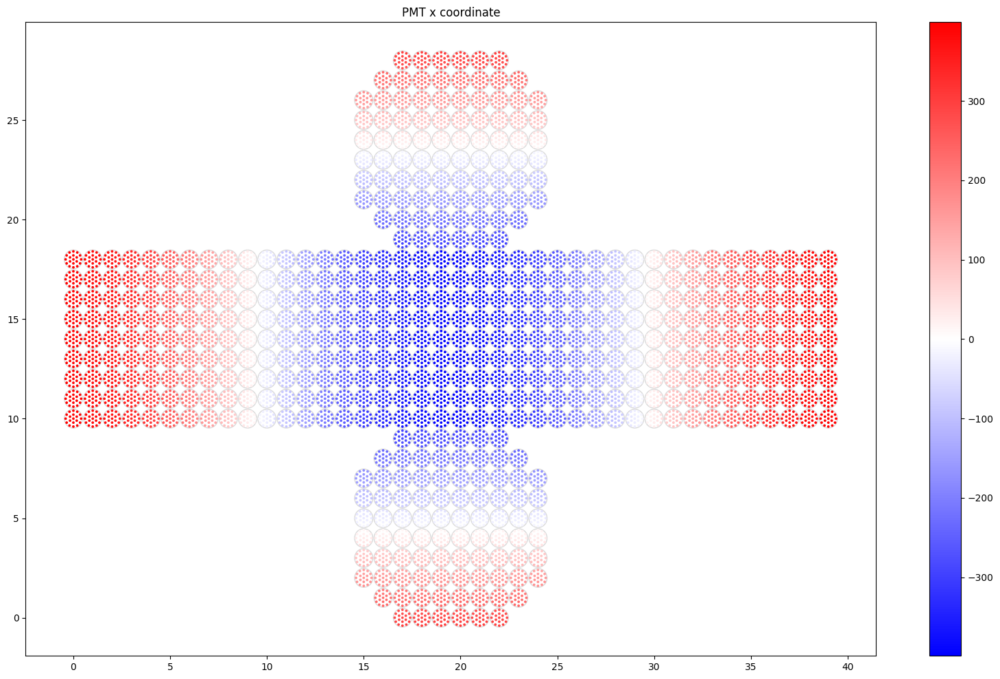

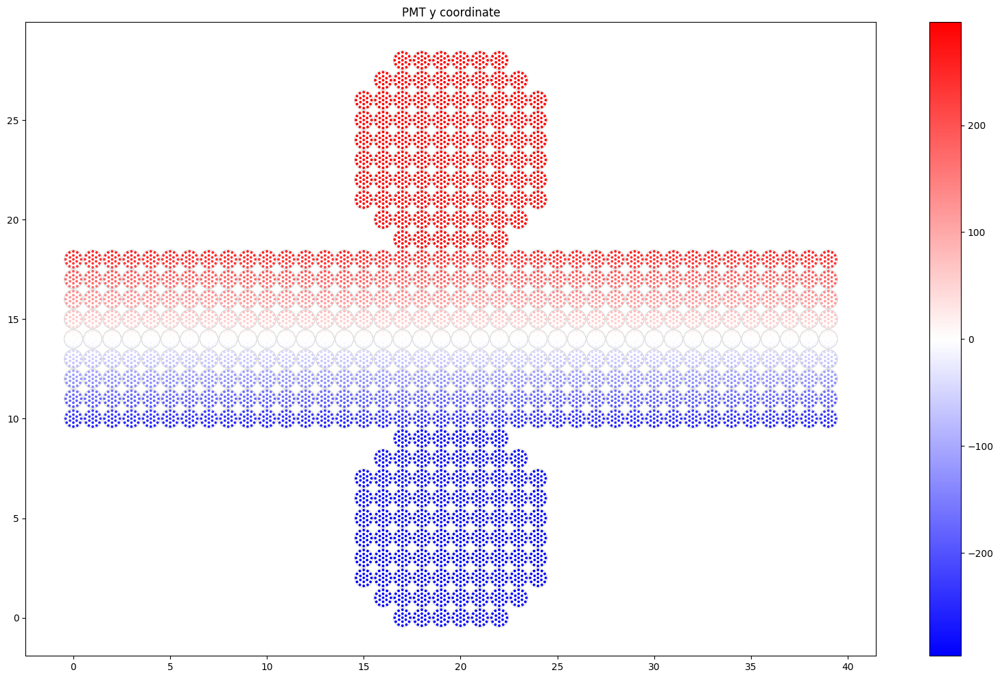

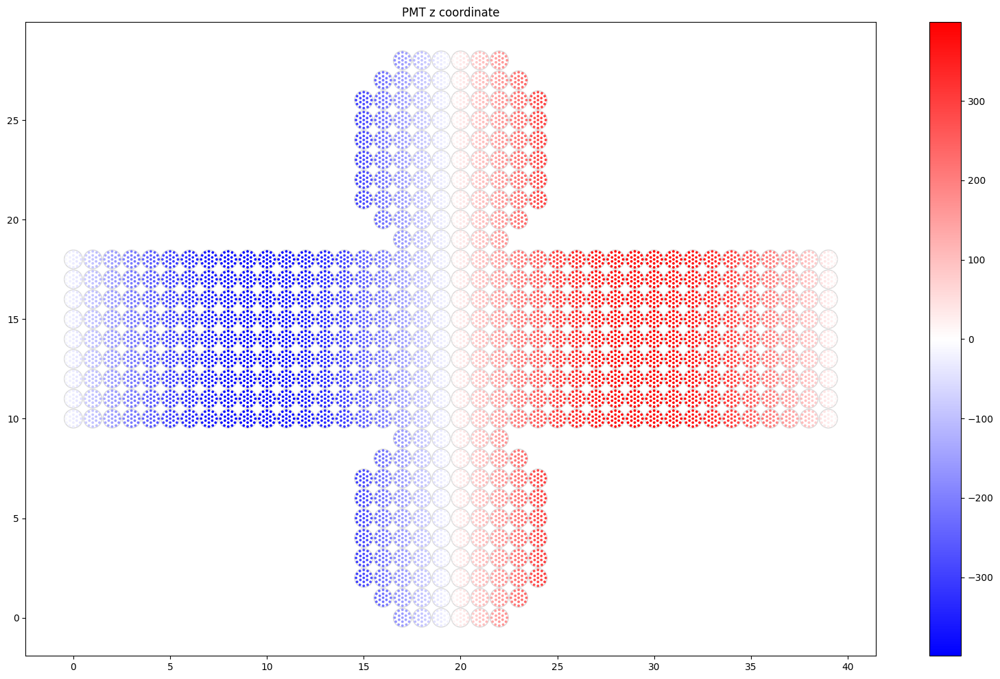

In [10]:
# use color map with zero set to white so that non-physical mPMT locations don't show
plot_event(pos_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="PMT x coordinate")
plot_event(pos_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="PMT y coordinate")
plot_event(pos_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="PMT z coordinate")

### Test plots of x, y and z positions of each PMT relative to central PMT of the mPMT module

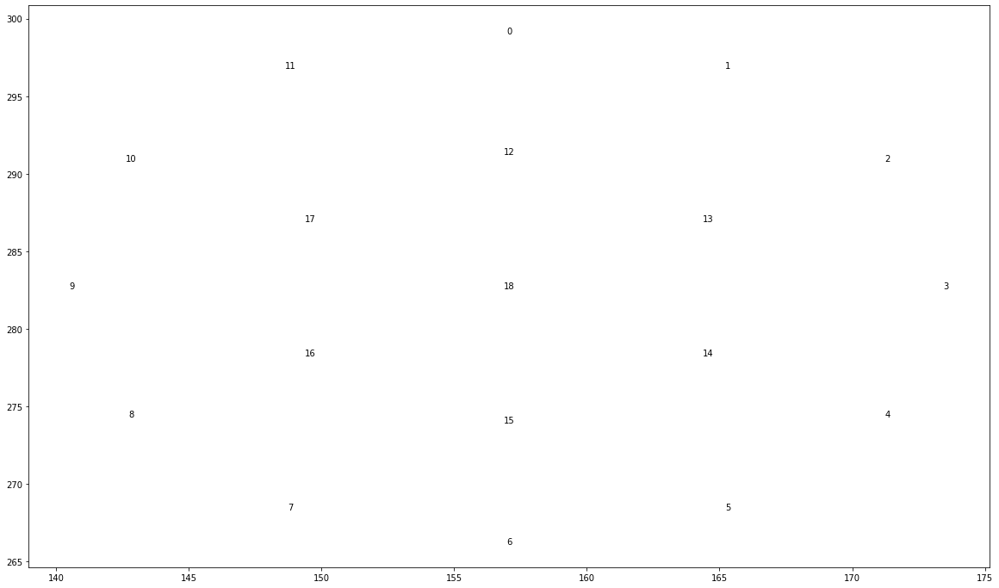

In [11]:
fig = plt.figure(figsize=(20,12))
ax = fig.add_subplot(111)
ax.scatter(geo_positions_short[-19:,2],geo_positions_short[-19:,0], alpha=0)
for i, pos in zip(pmt_ids_short[-19:], geo_positions_short[-19:]):
    ax.text(pos[2],pos[0],i%19, ha="center", va="center")

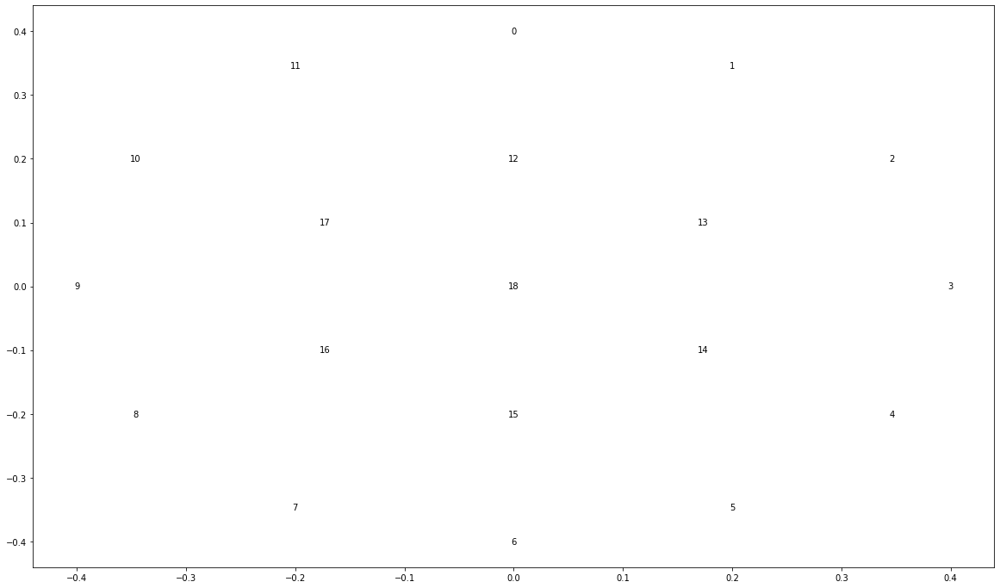

In [12]:
fig = plt.figure(figsize=(20,12))
ax = fig.add_subplot(111)
test_positions_short = np.array(channel_to_position(pmt_ids_short[-19:])).T
ax.scatter(test_positions_short[:,1], test_positions_short[:,0], alpha=0)
for i, pos in zip(pmt_ids_short[-19:], test_positions_short):
    ax.text(pos[1],pos[0],i%19, ha="center", va="center")

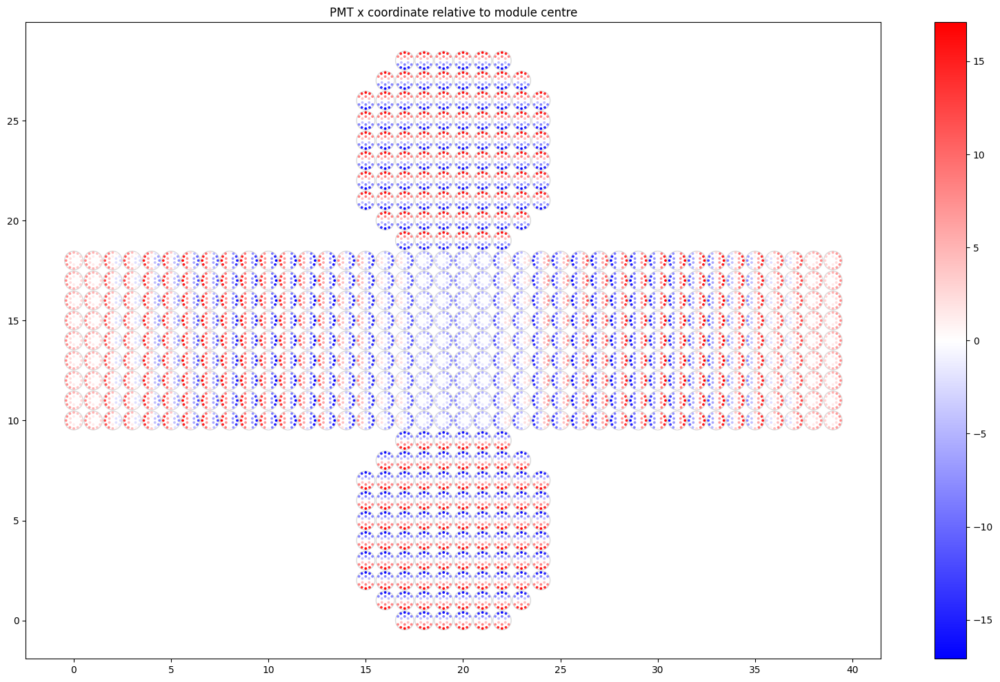

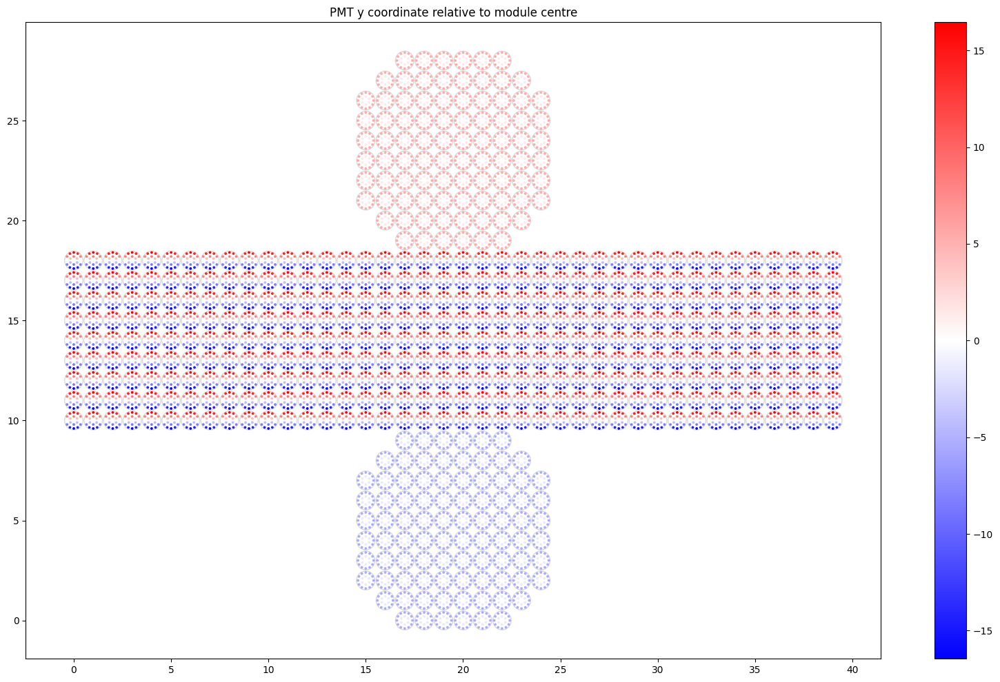

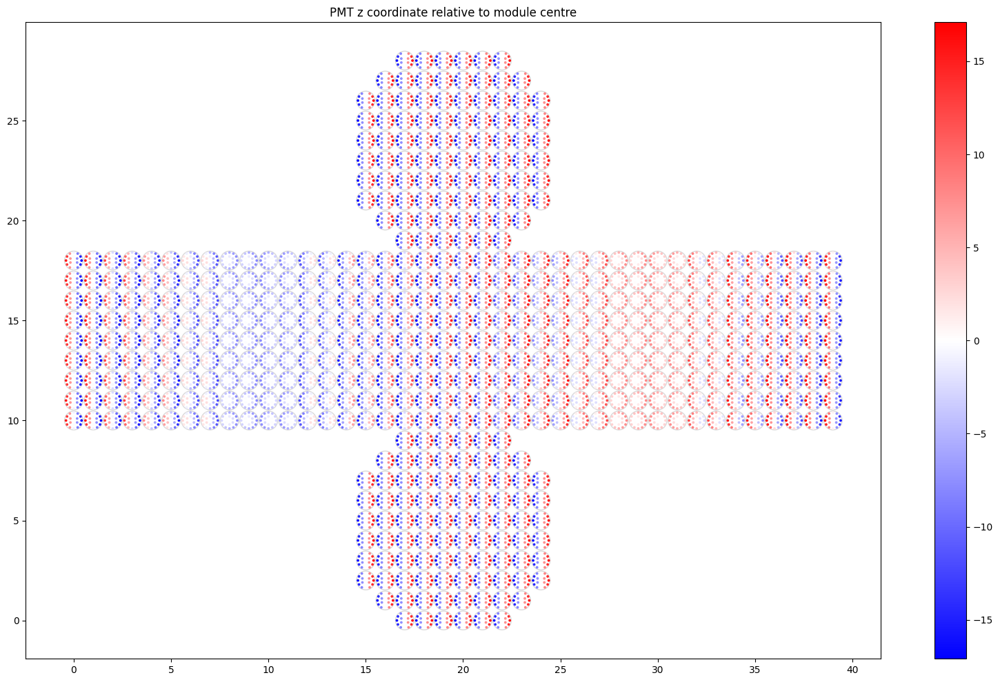

In [13]:
geo_positions_offset_short = geo_positions_short[pmt_ids_short] - geo_positions_short[(pmt_ids_short//19)*19+18]
offset_data_x_short = dataset_short.process_data(pmt_ids_short, geo_positions_offset_short[:,0])
offset_data_y_short = dataset_short.process_data(pmt_ids_short, geo_positions_offset_short[:,1])
offset_data_z_short = dataset_short.process_data(pmt_ids_short, geo_positions_offset_short[:,2])
# use color map with zero set to white so that non-physical mPMT locations don't show
plot_event(offset_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="PMT x coordinate relative to module centre")
plot_event(offset_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="PMT y coordinate relative to module centre")
plot_event(offset_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="PMT z coordinate relative to module centre")

### Test plots of x, y and z orientation values of each PMT

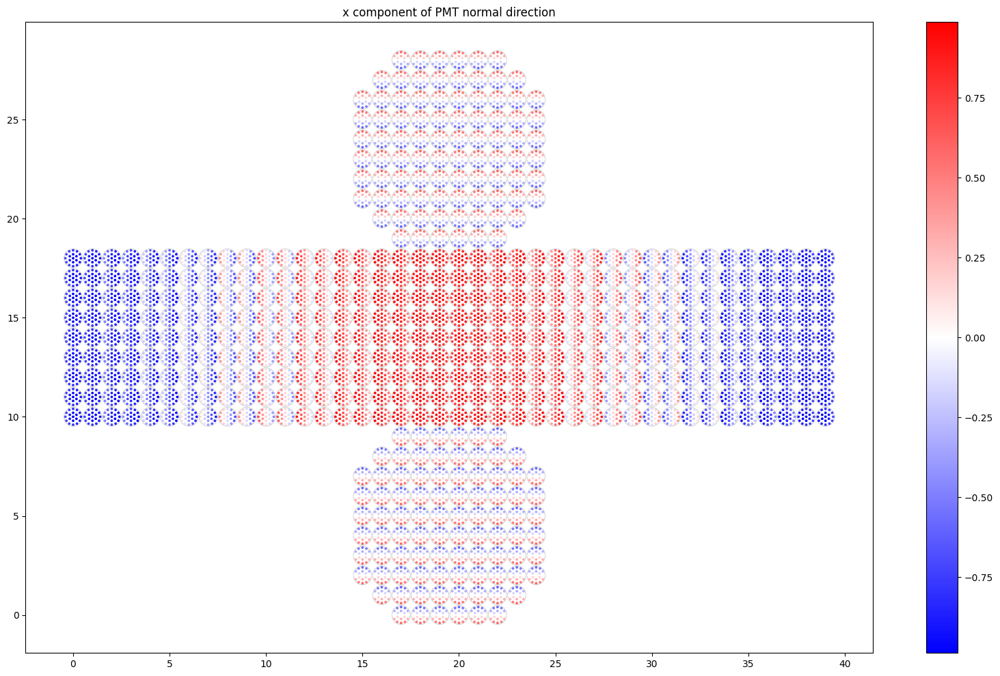

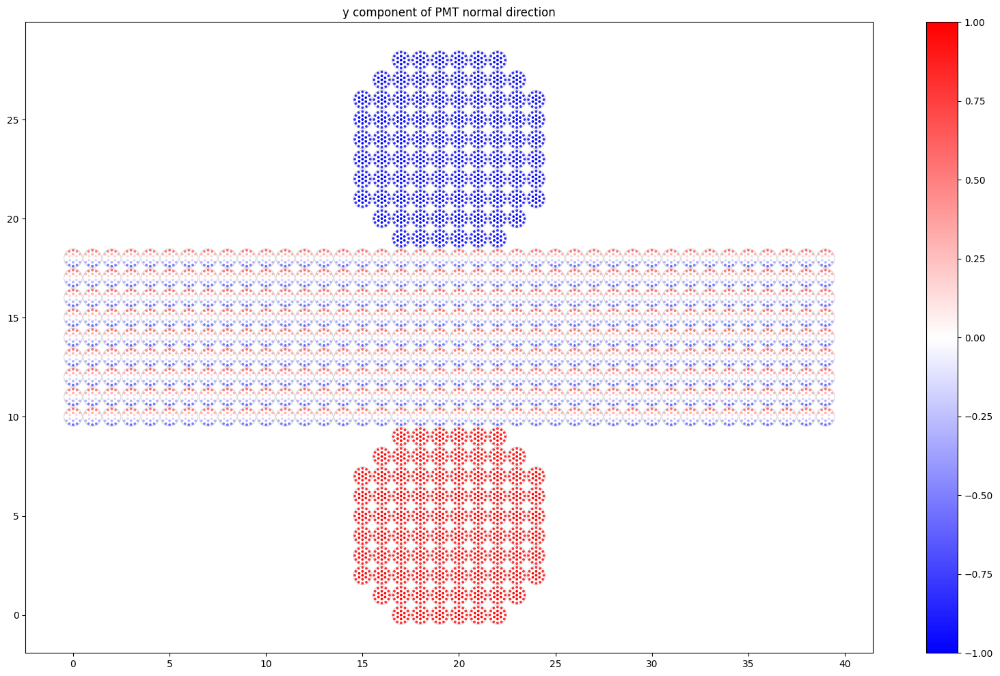

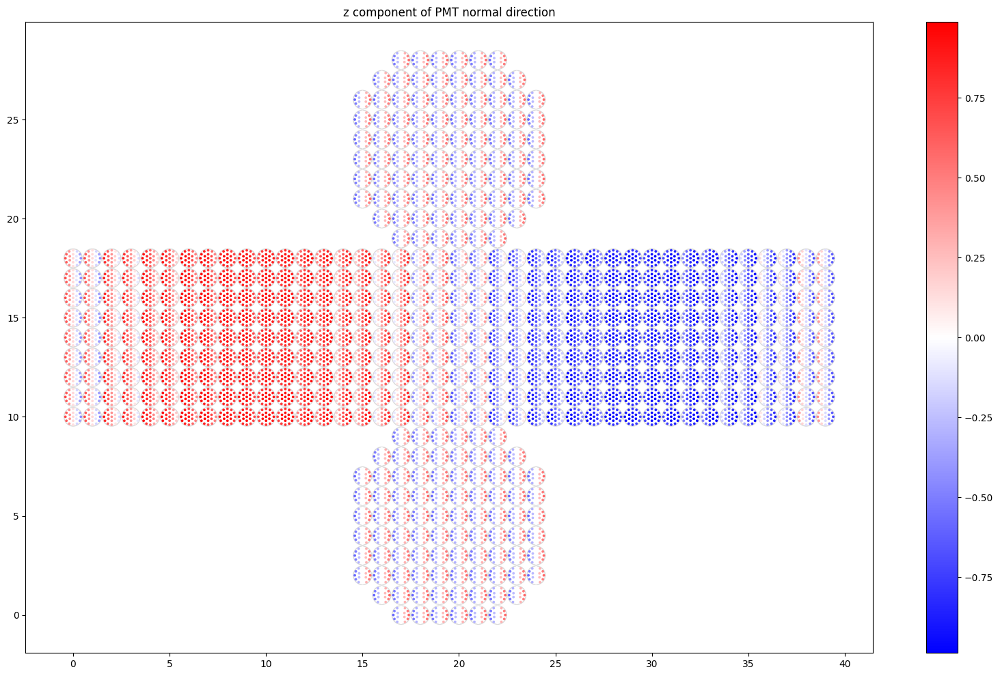

In [14]:
geo_orientations_short = geo_file_short["orientation"]
orientation_data_x_short = dataset_short.process_data(pmt_ids_short, geo_orientations_short[:,0])
orientation_data_y_short = dataset_short.process_data(pmt_ids_short, geo_orientations_short[:,1])
orientation_data_z_short = dataset_short.process_data(pmt_ids_short, geo_orientations_short[:,2])
# use color map with zero set to white so that non-physical mPMT locations don't show
plot_event(orientation_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="x component of PMT normal direction")
plot_event(orientation_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="y component of PMT normal direction")
plot_event(orientation_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr, title="z component of PMT normal direction")

### Testing horizontal transformations

In [15]:
from watchmal.dataset.cnn_mpmt.transformations import horizontal_flip

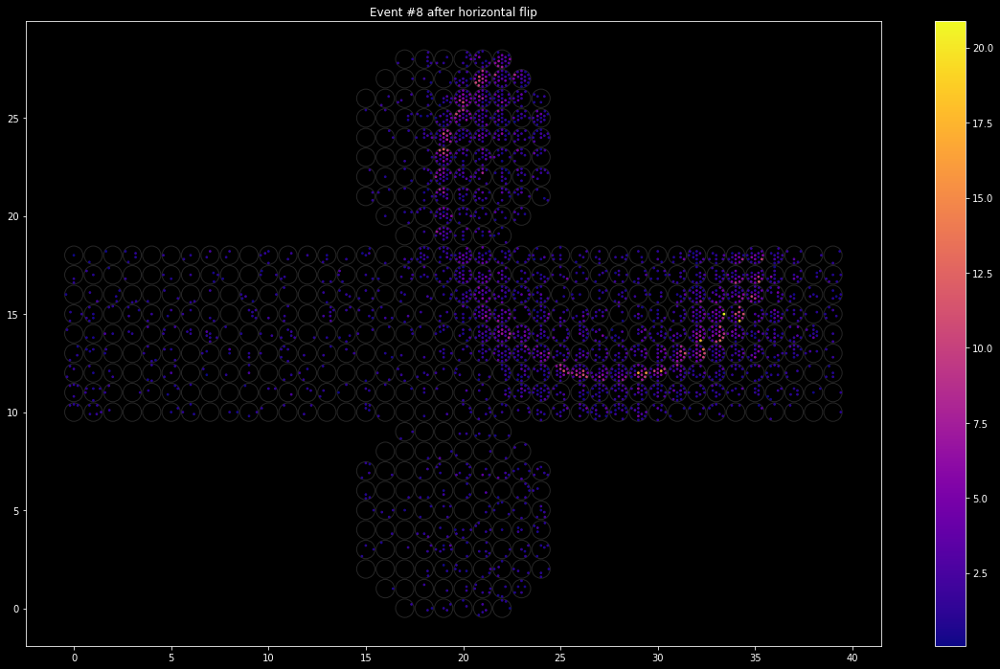

In [16]:
hflip_data_short = horizontal_flip(data_short)
plot_event(hflip_data_short, dataset_short.mpmt_positions, style="dark_background", cmap=plt.cm.plasma,
           title="Event #8 after horizontal flip")

In [17]:
hflip_pos_data_x_short = horizontal_flip(torch.from_numpy(pos_data_x_short))
hflip_pos_data_y_short = horizontal_flip(torch.from_numpy(pos_data_y_short))
hflip_pos_data_z_short = horizontal_flip(torch.from_numpy(pos_data_z_short))
hflip_offset_data_x_short = horizontal_flip(torch.from_numpy(offset_data_x_short))
hflip_offset_data_y_short = horizontal_flip(torch.from_numpy(offset_data_y_short))
hflip_offset_data_z_short = horizontal_flip(torch.from_numpy(offset_data_z_short))
hflip_orientation_data_x_short = horizontal_flip(torch.from_numpy(orientation_data_x_short))
hflip_orientation_data_y_short = horizontal_flip(torch.from_numpy(orientation_data_y_short))
hflip_orientation_data_z_short = horizontal_flip(torch.from_numpy(orientation_data_z_short))

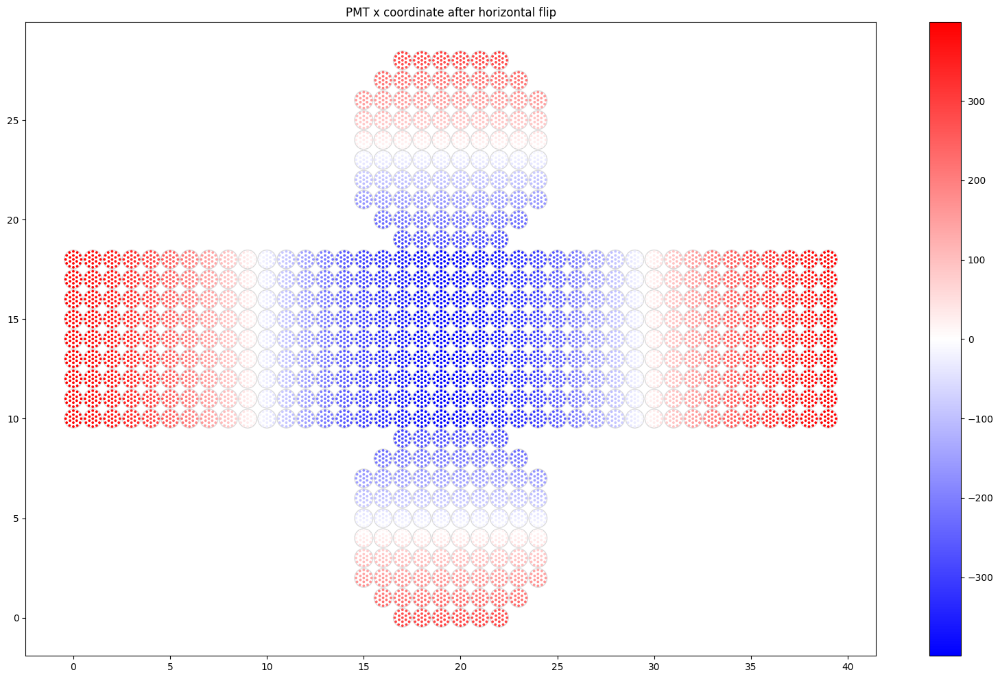

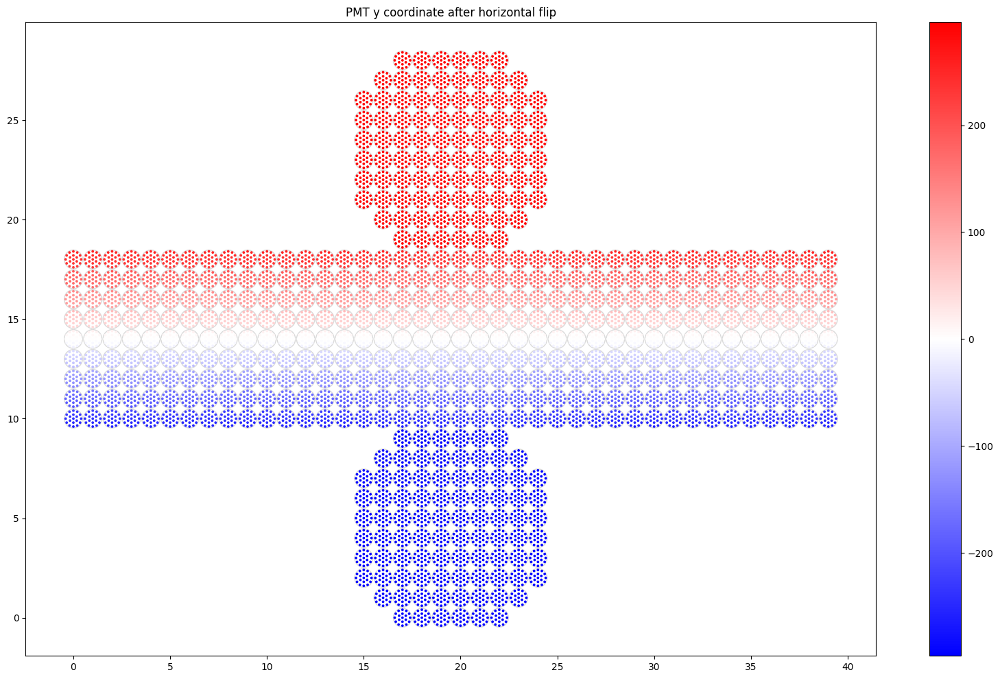

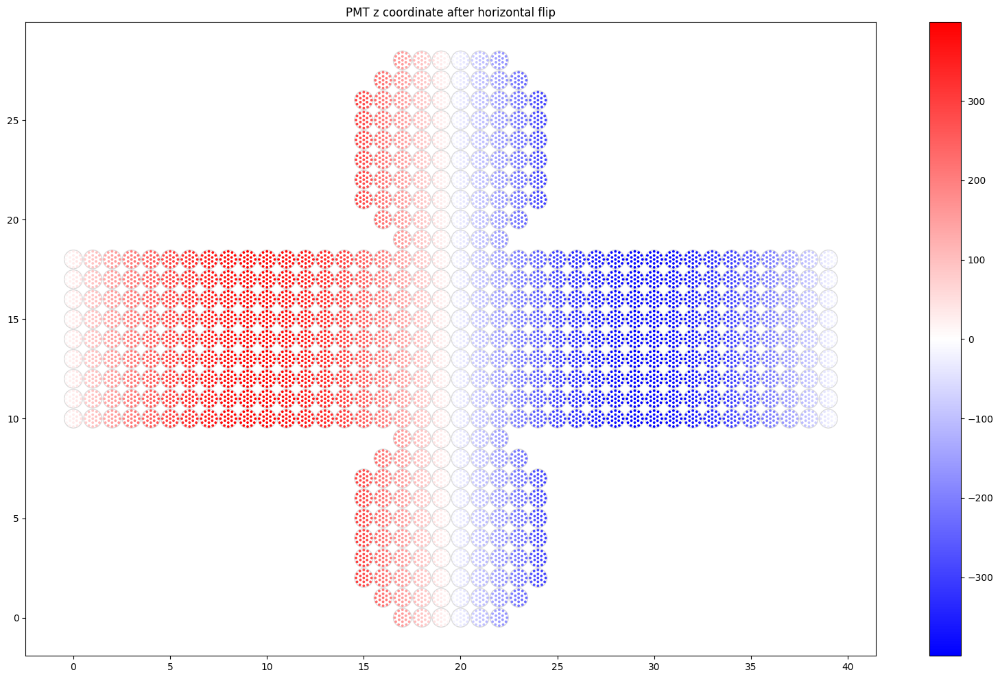

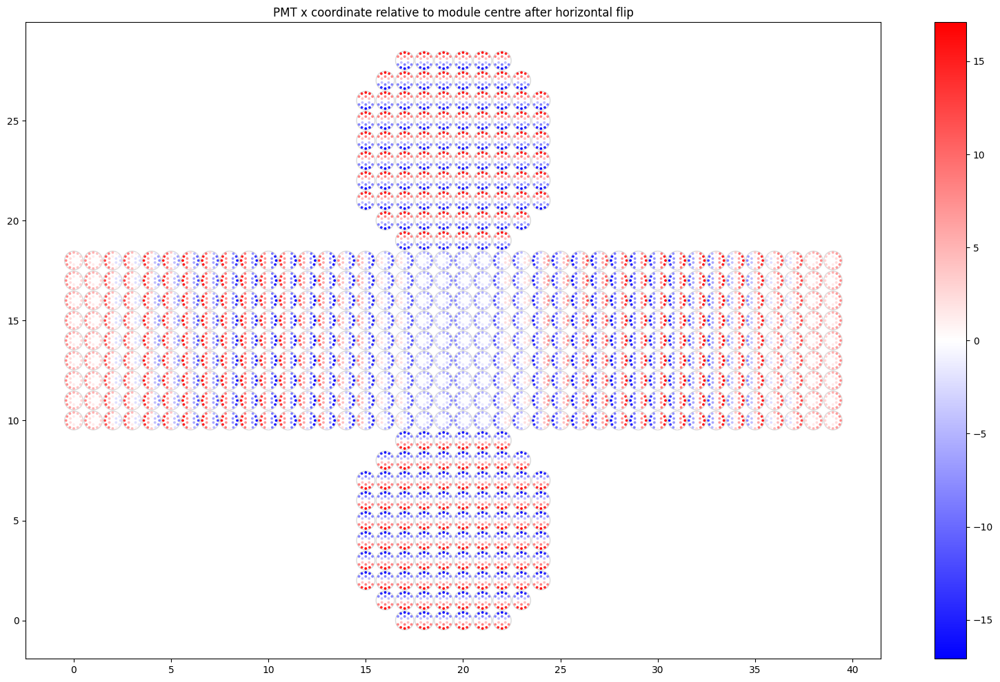

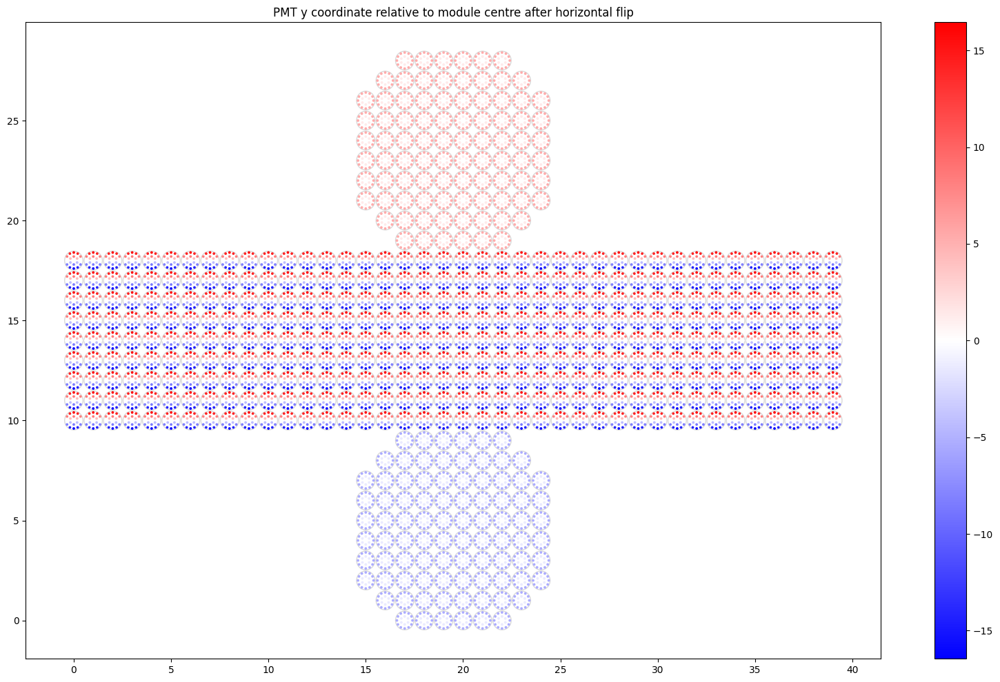

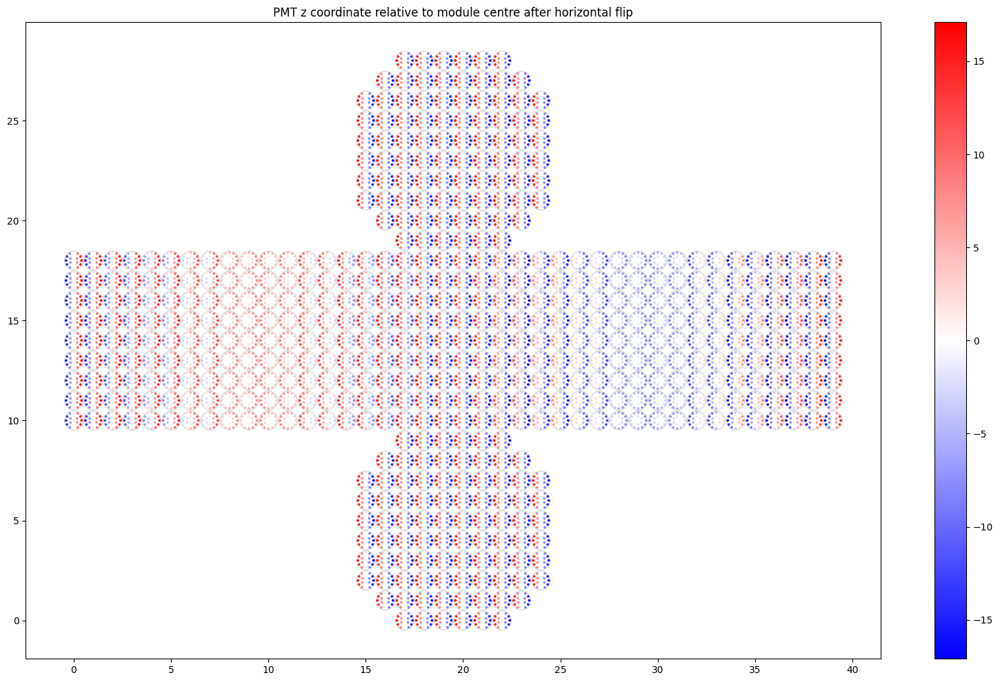

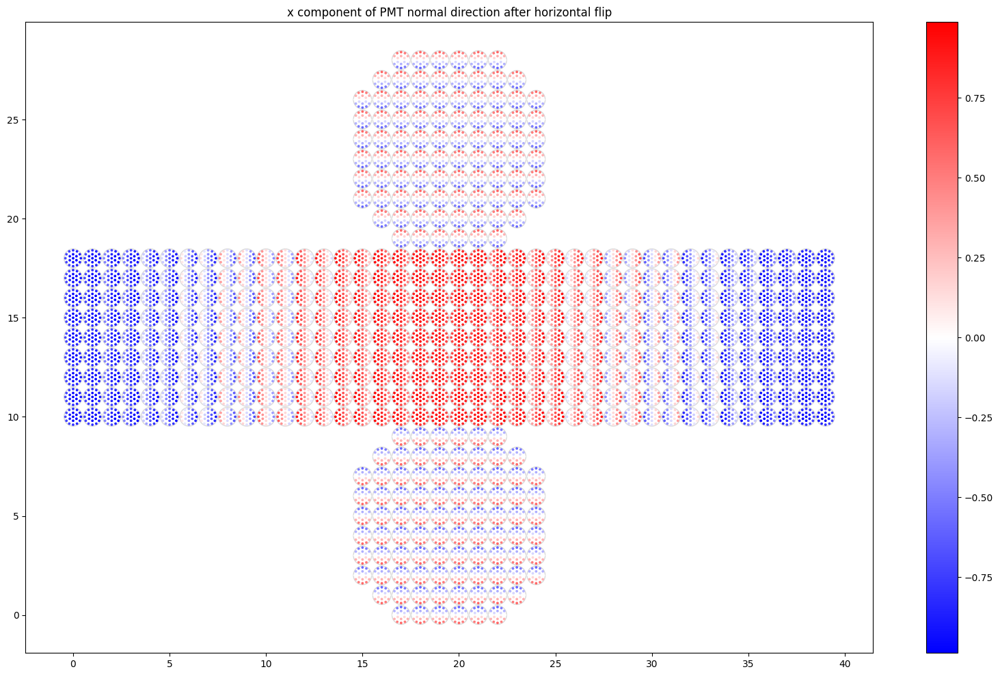

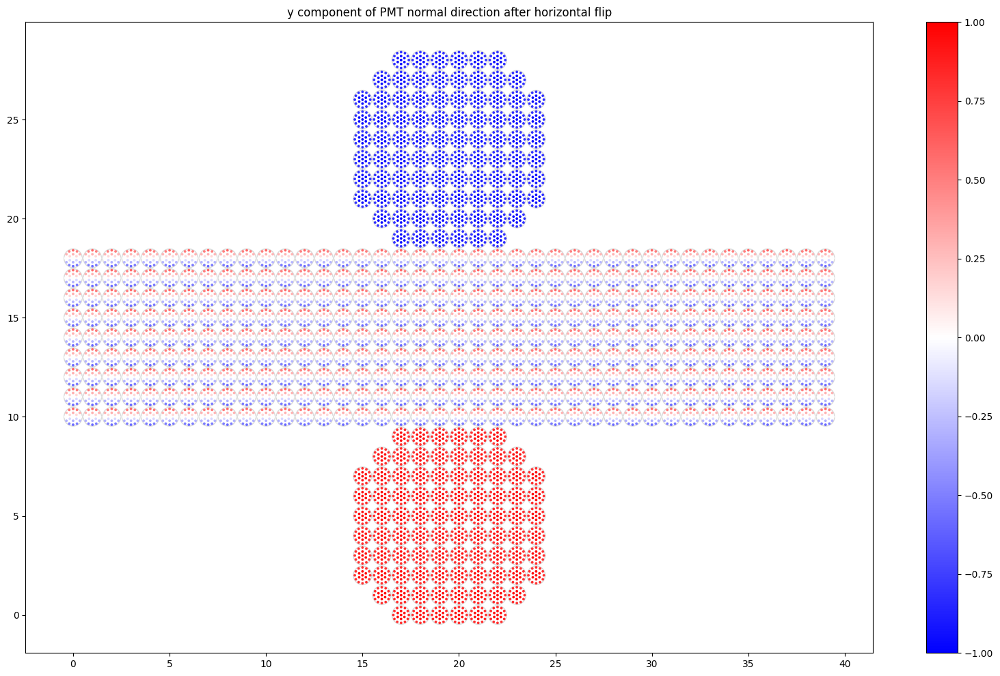

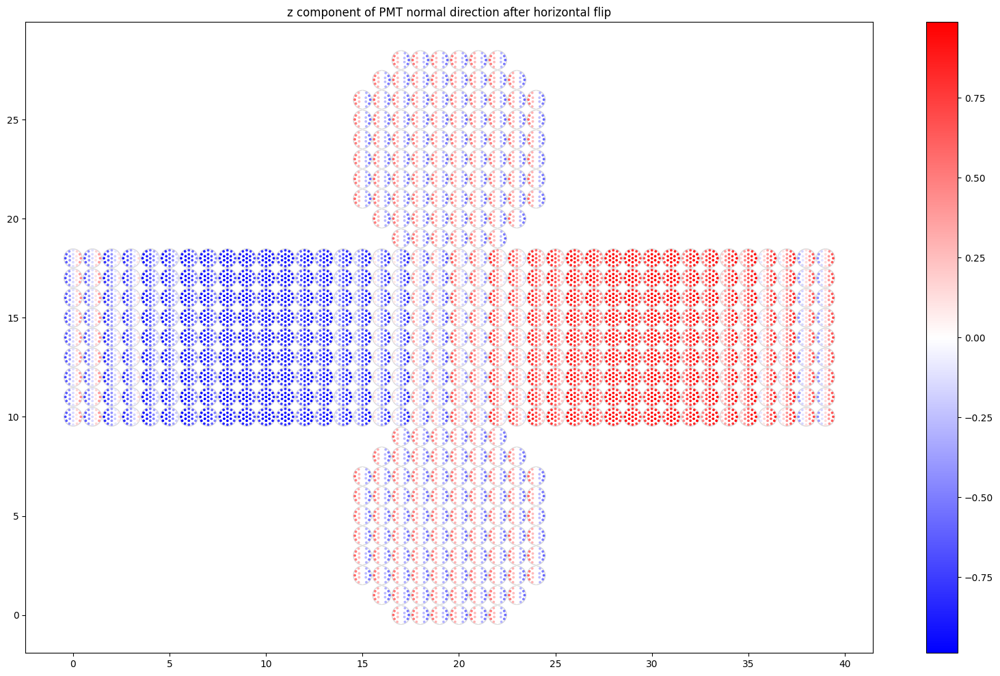

In [18]:
plot_event(hflip_pos_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT x coordinate after horizontal flip")
plot_event(hflip_pos_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT y coordinate after horizontal flip")
plot_event(hflip_pos_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT z coordinate after horizontal flip")
plot_event(hflip_offset_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT x coordinate relative to module centre after horizontal flip")
plot_event(hflip_offset_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT y coordinate relative to module centre after horizontal flip")
plot_event(hflip_offset_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT z coordinate relative to module centre after horizontal flip")
plot_event(hflip_orientation_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="x component of PMT normal direction after horizontal flip")
plot_event(hflip_orientation_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="y component of PMT normal direction after horizontal flip")
plot_event(hflip_orientation_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="z component of PMT normal direction after horizontal flip")

### Testing vertical transformations

In [19]:
from watchmal.dataset.cnn_mpmt.transformations import vertical_flip

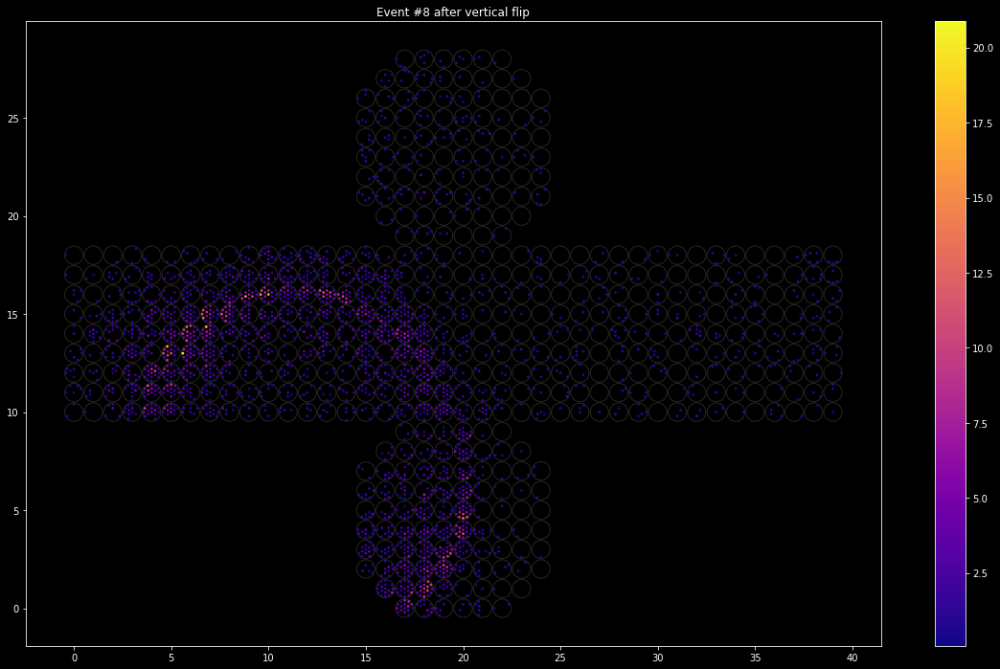

In [20]:
vflip_data_short = vertical_flip(data_short)
plot_event(vflip_data_short, dataset_short.mpmt_positions, style="dark_background", cmap=plt.cm.plasma,
           title="Event #8 after vertical flip")

In [21]:
vflip_pos_data_x_short = vertical_flip(torch.from_numpy(pos_data_x_short))
vflip_pos_data_y_short = vertical_flip(torch.from_numpy(pos_data_y_short))
vflip_pos_data_z_short = vertical_flip(torch.from_numpy(pos_data_z_short))
vflip_offset_data_x_short = vertical_flip(torch.from_numpy(offset_data_x_short))
vflip_offset_data_y_short = vertical_flip(torch.from_numpy(offset_data_y_short))
vflip_offset_data_z_short = vertical_flip(torch.from_numpy(offset_data_z_short))
vflip_orientation_data_x_short = vertical_flip(torch.from_numpy(orientation_data_x_short))
vflip_orientation_data_y_short = vertical_flip(torch.from_numpy(orientation_data_y_short))
vflip_orientation_data_z_short = vertical_flip(torch.from_numpy(orientation_data_z_short))

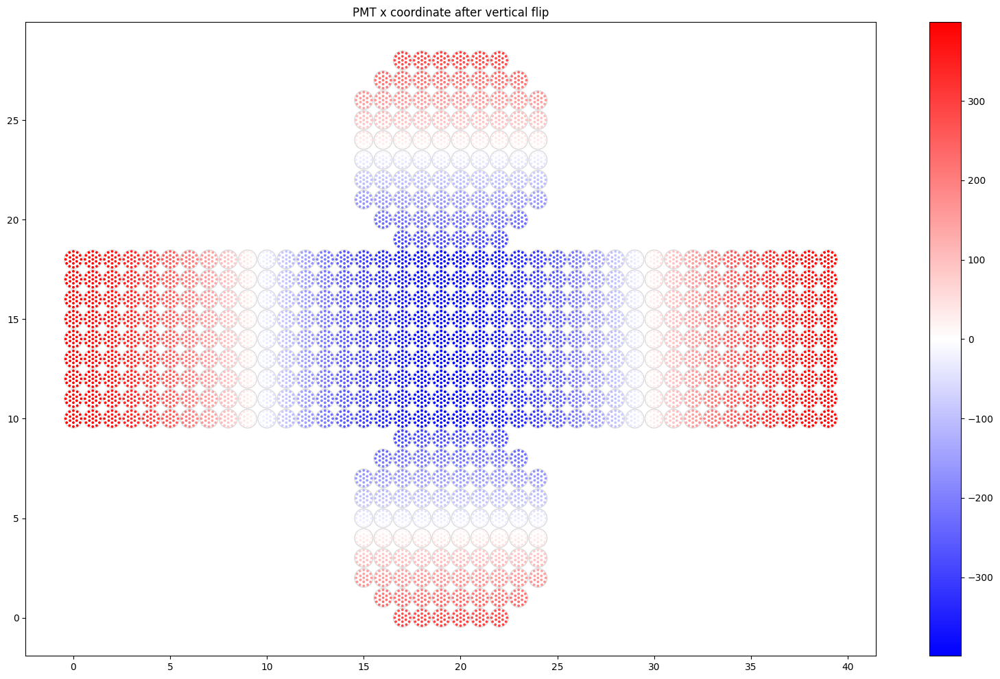

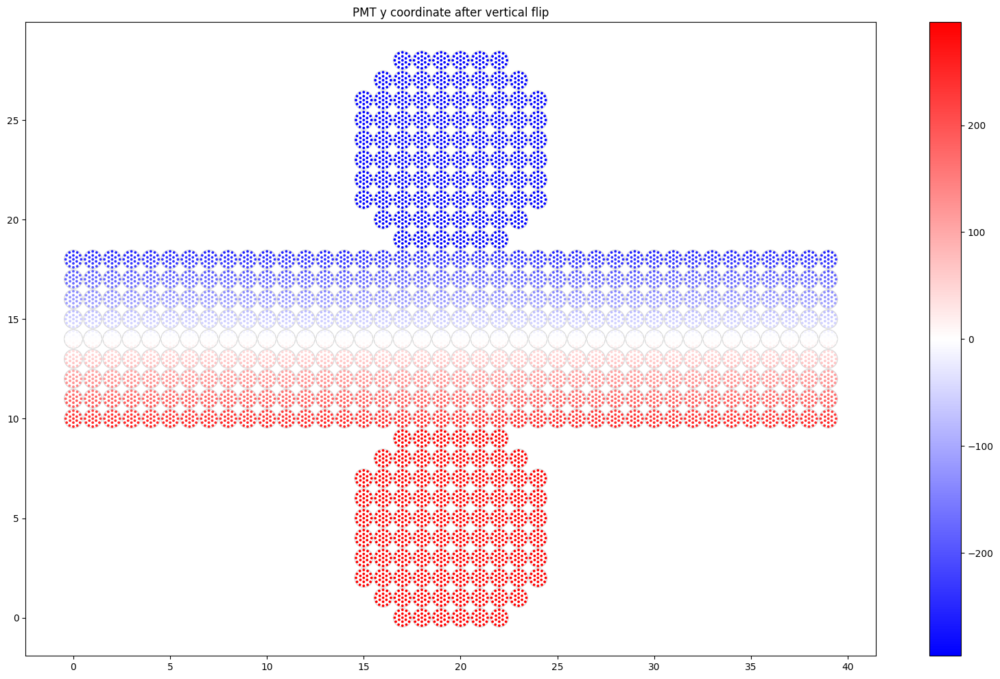

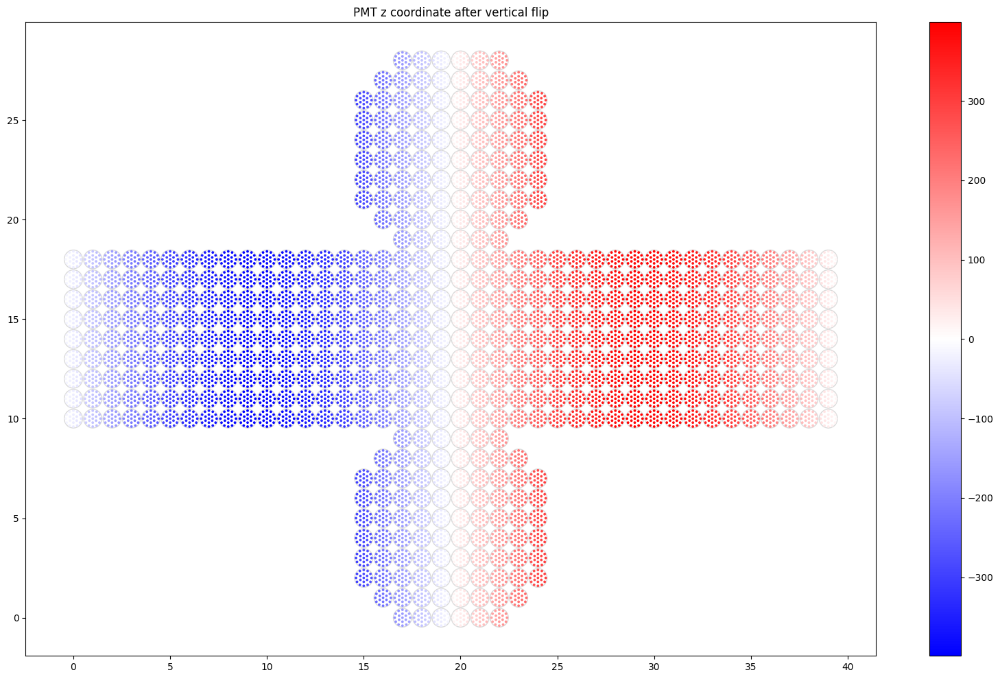

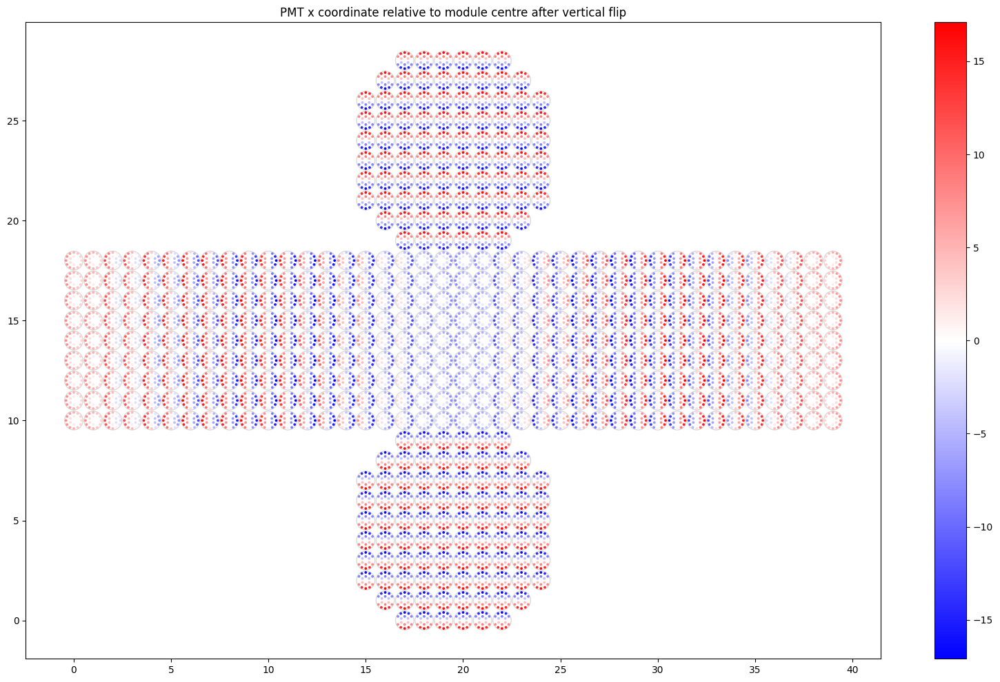

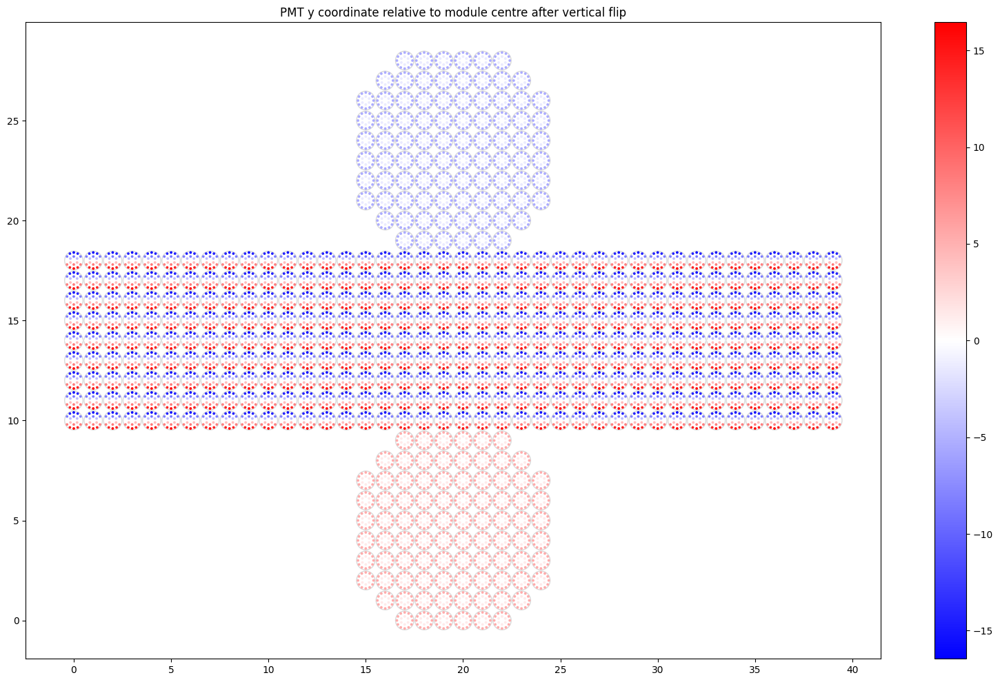

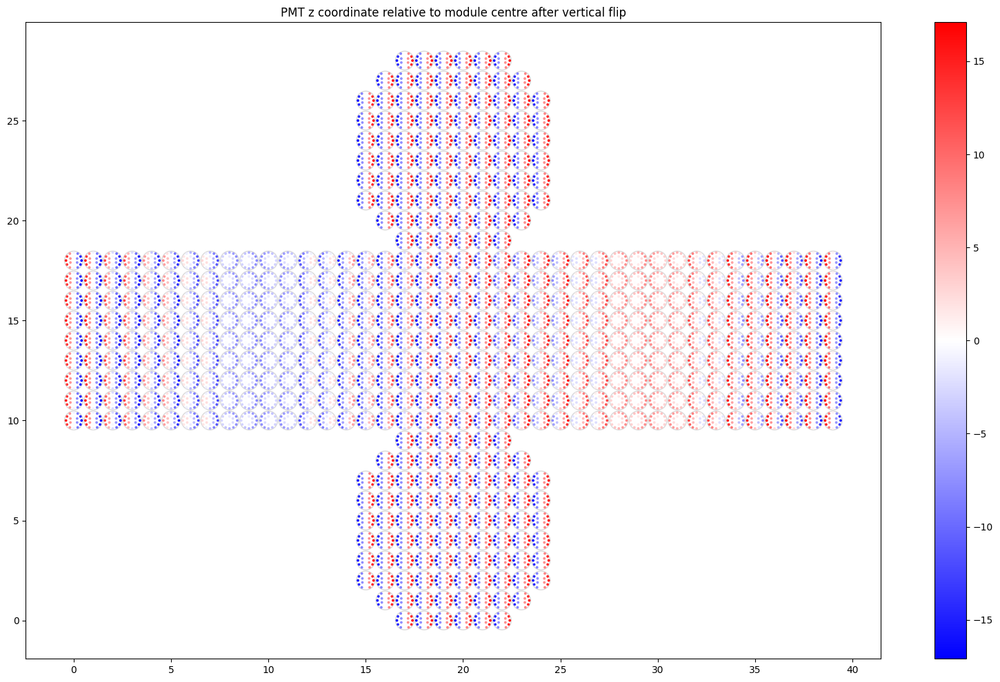

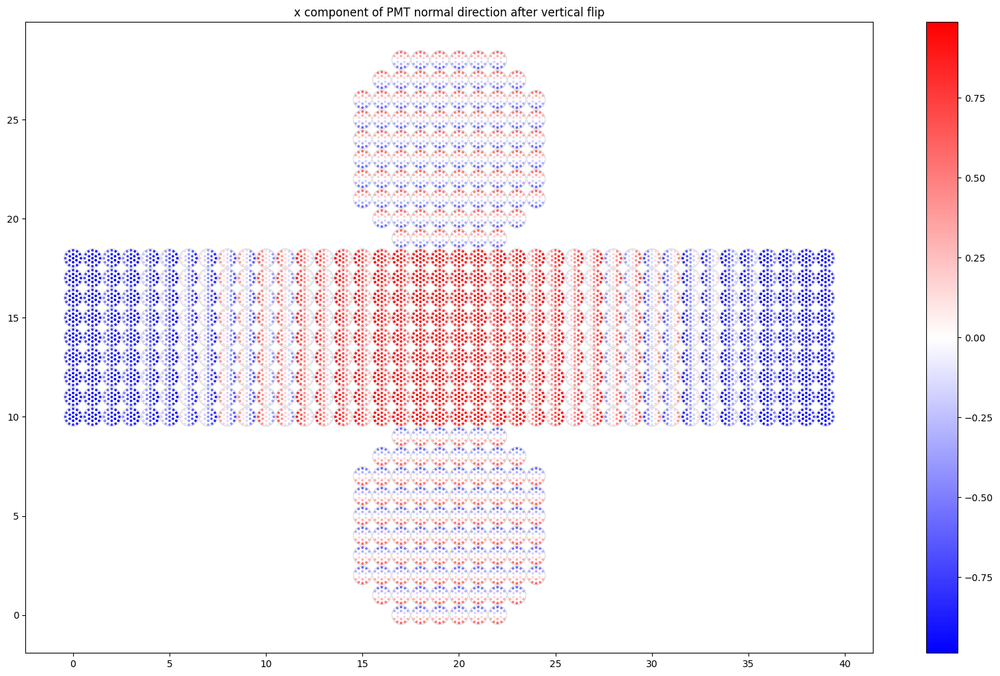

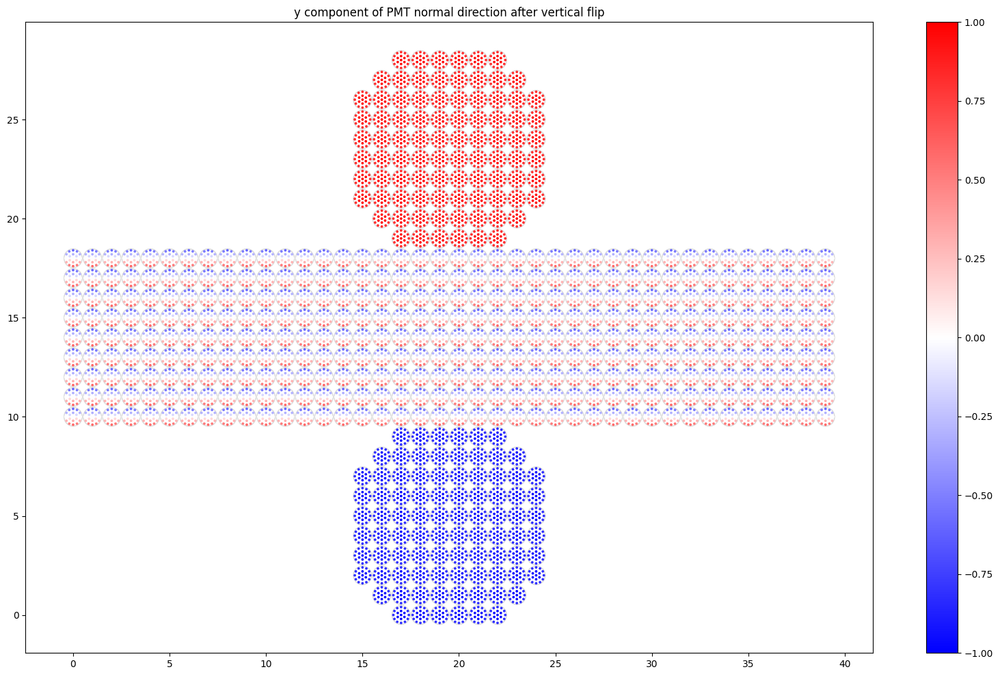

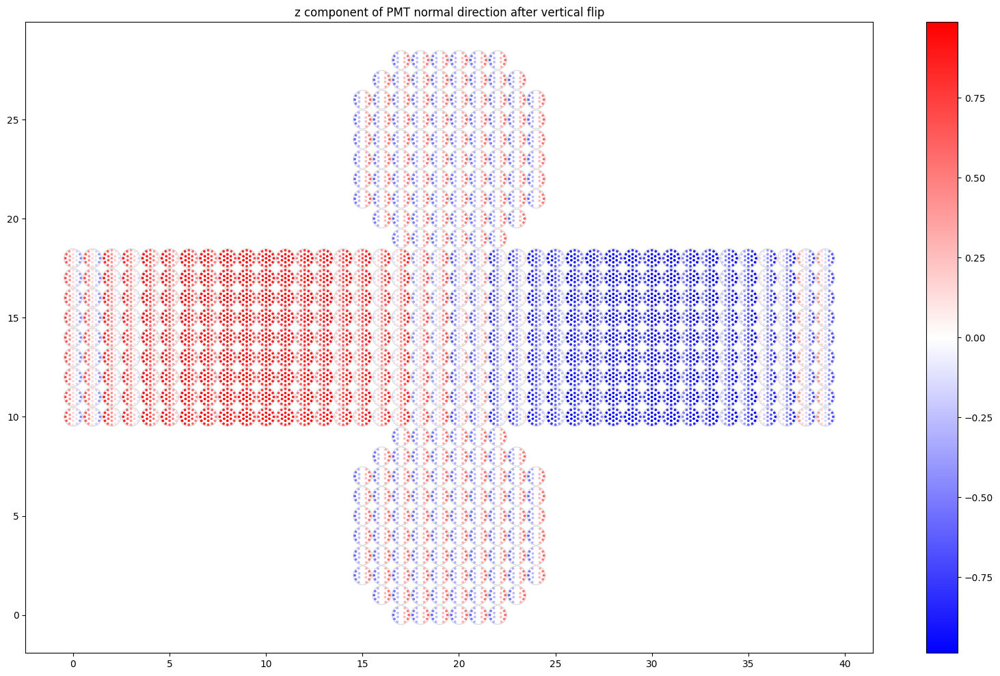

In [22]:
plot_event(vflip_pos_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT x coordinate after vertical flip")
plot_event(vflip_pos_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT y coordinate after vertical flip")
plot_event(vflip_pos_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT z coordinate after vertical flip")
plot_event(vflip_offset_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT x coordinate relative to module centre after vertical flip")
plot_event(vflip_offset_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT y coordinate relative to module centre after vertical flip")
plot_event(vflip_offset_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="PMT z coordinate relative to module centre after vertical flip")
plot_event(vflip_orientation_data_x_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="x component of PMT normal direction after vertical flip")
plot_event(vflip_orientation_data_y_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="y component of PMT normal direction after vertical flip")
plot_event(vflip_orientation_data_z_short, dataset_short.mpmt_positions, cmap=plt.cm.bwr,
           title="z component of PMT normal direction after vertical flip")

## Testing with long tank data

### Loading data and plotting test event

In [23]:
dataset_long = CNNmPMTDataset(h5file='/fast_scratch/WatChMaL/data/IWCDmPMT_4pi_full_tank_pointnet.h5',
                         mpmt_positions_file='/data/WatChMaL/data/IWCD_mPMT_image_positions.npz',
                         is_distributed=False)

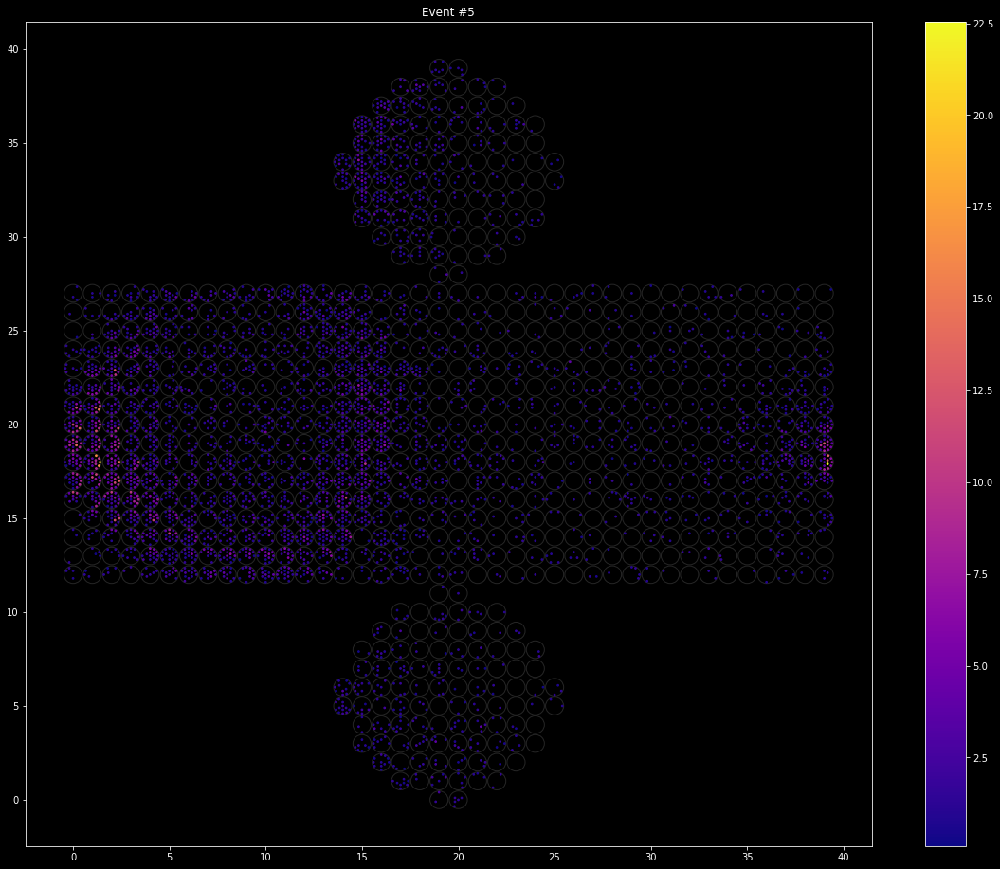

In [24]:
data_long = dataset_long.__getitem__(5)['data']
plot_event(data_long, dataset_long.mpmt_positions, old_convention=True, style="dark_background",
           cmap=plt.cm.plasma, title="Event #5")

### Test plots of x, y and z position values of each PMT

In [25]:
geo_file_long = np.load("/fast_scratch/WatChMaL/data/mPMT_full_geo.npz", 'r')
geo_positions_long = geo_file_long["position"]
pmt_ids_long = np.arange(geo_positions_long.shape[0])
pos_data_x_long = dataset_long.process_data(pmt_ids_long, geo_positions_long[:,0])
pos_data_y_long = dataset_long.process_data(pmt_ids_long, geo_positions_long[:,1])
pos_data_z_long = dataset_long.process_data(pmt_ids_long, geo_positions_long[:,2])

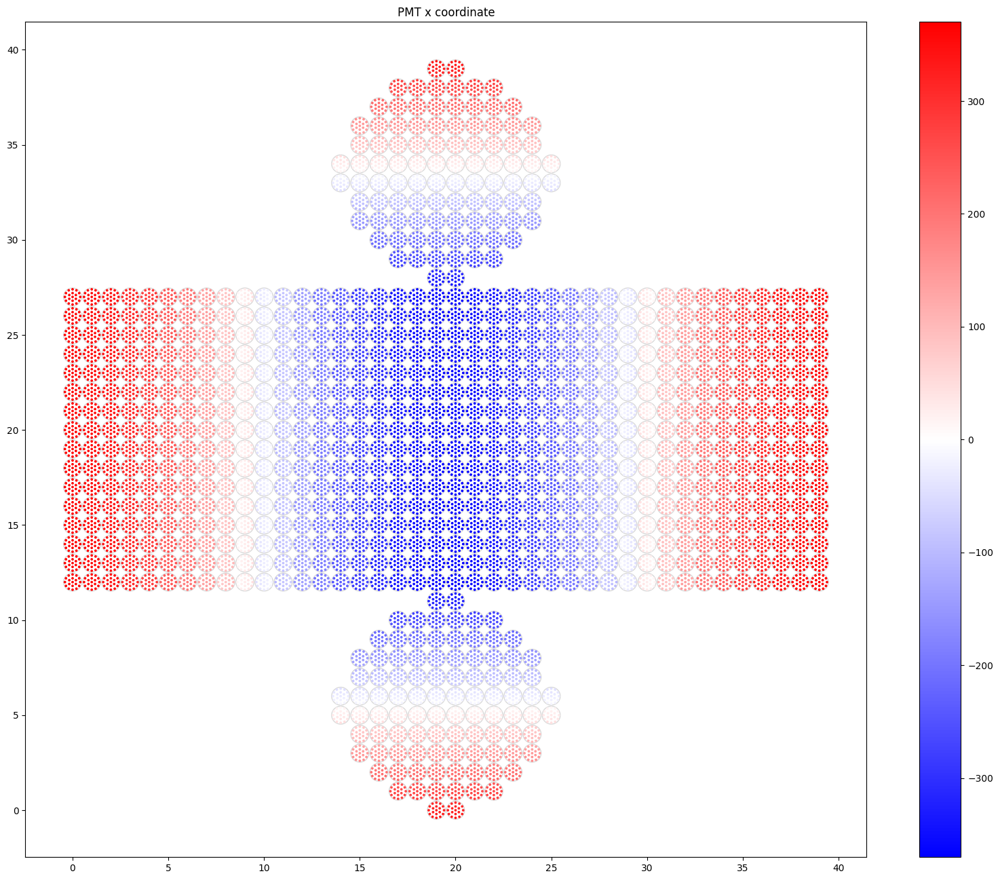

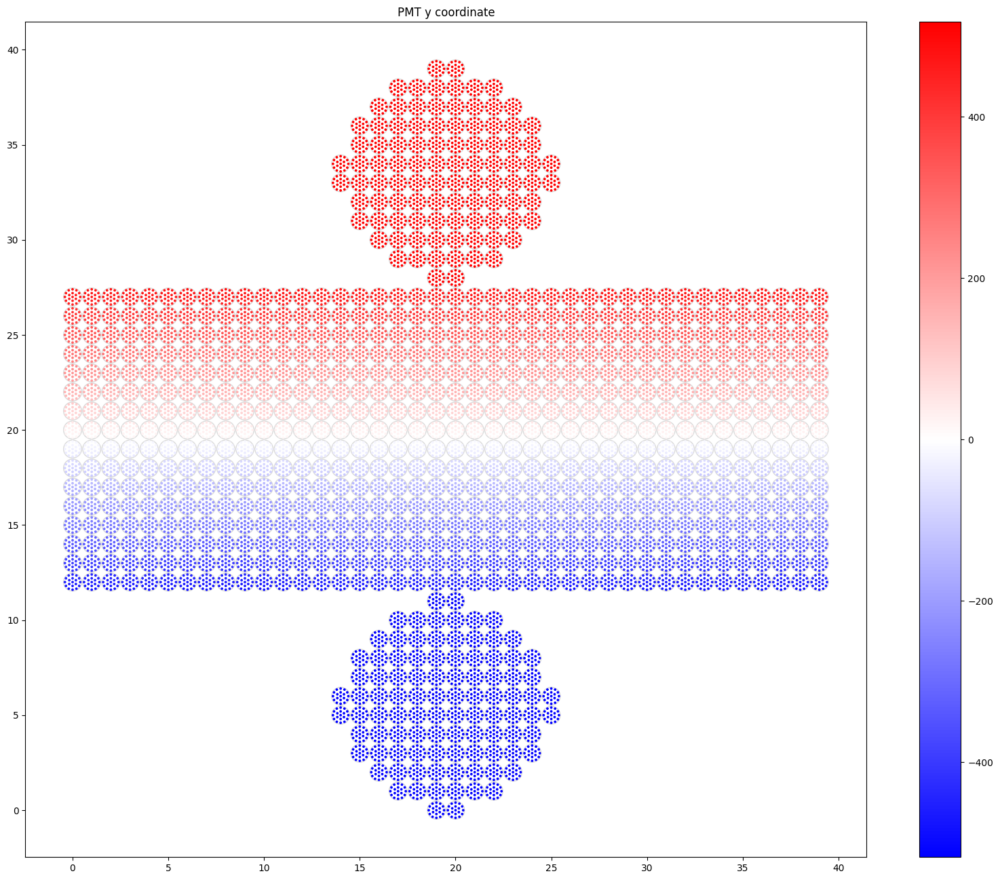

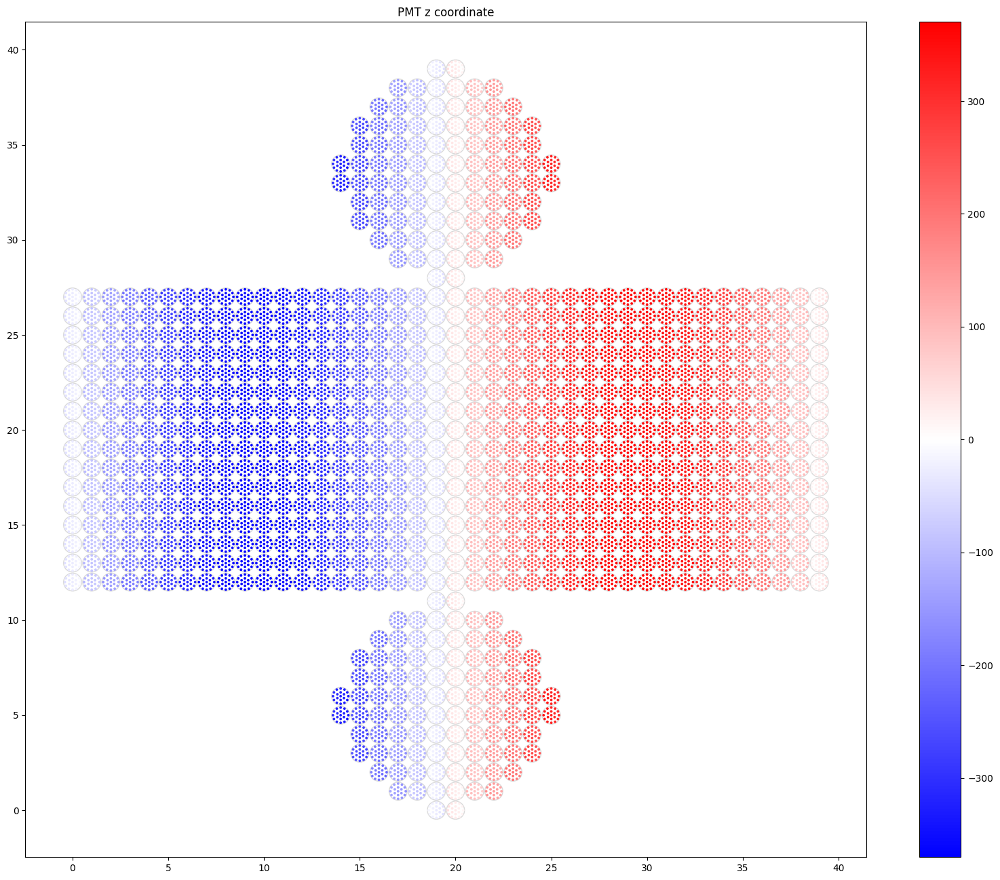

In [26]:
# use color map with zero set to white so that non-physical mPMT locations don't show
plot_event(pos_data_x_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="PMT x coordinate")
plot_event(pos_data_y_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="PMT y coordinate")
plot_event(pos_data_z_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="PMT z coordinate")

### Test plots of x, y and z positions of each PMT relative to central PMT of the mPMT module

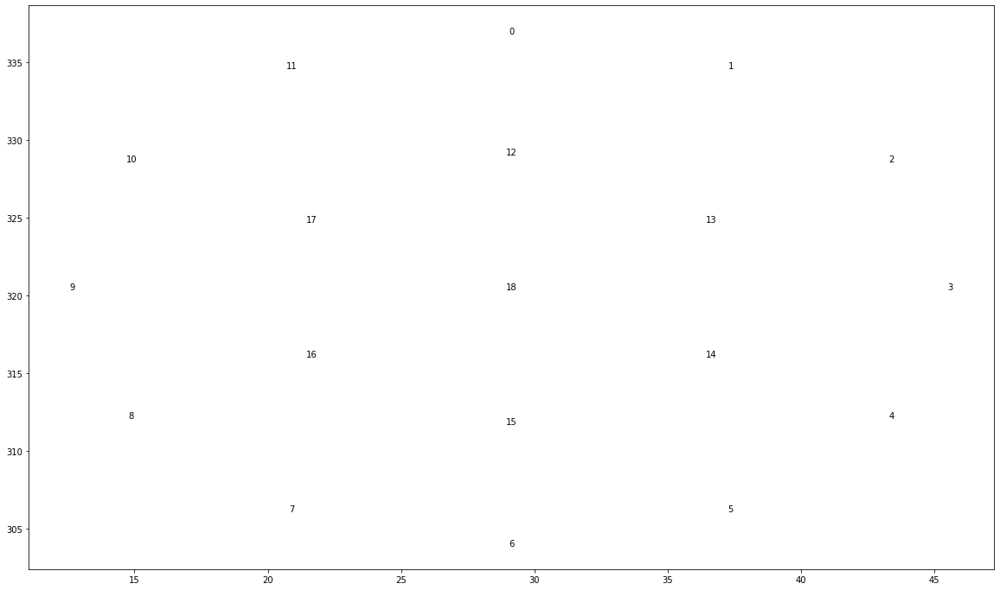

In [27]:
fig = plt.figure(figsize=(20,12))
ax = fig.add_subplot(111)
ax.scatter(geo_positions_long[-19:,2],geo_positions_long[-19:,0], alpha=0)
for i, pos in zip(pmt_ids_long[-19:], geo_positions_long[-19:]):
    ax.text(pos[2],pos[0],i%19, ha="center", va="center")

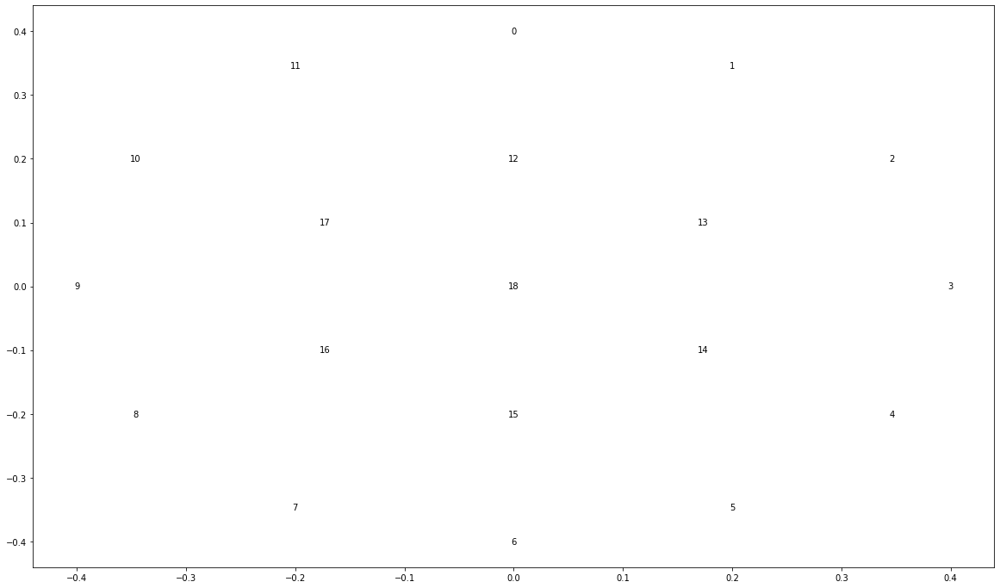

In [28]:
fig = plt.figure(figsize=(20,12))
ax = fig.add_subplot(111)
test_positions_long = np.array(channel_to_position(pmt_ids_long[-19:])).T
ax.scatter(test_positions_long[:,1], test_positions_long[:,0], alpha=0)
for i, pos in zip(pmt_ids_long[-19:], test_positions_long):
    ax.text(pos[1],pos[0],i%19, ha="center", va="center")

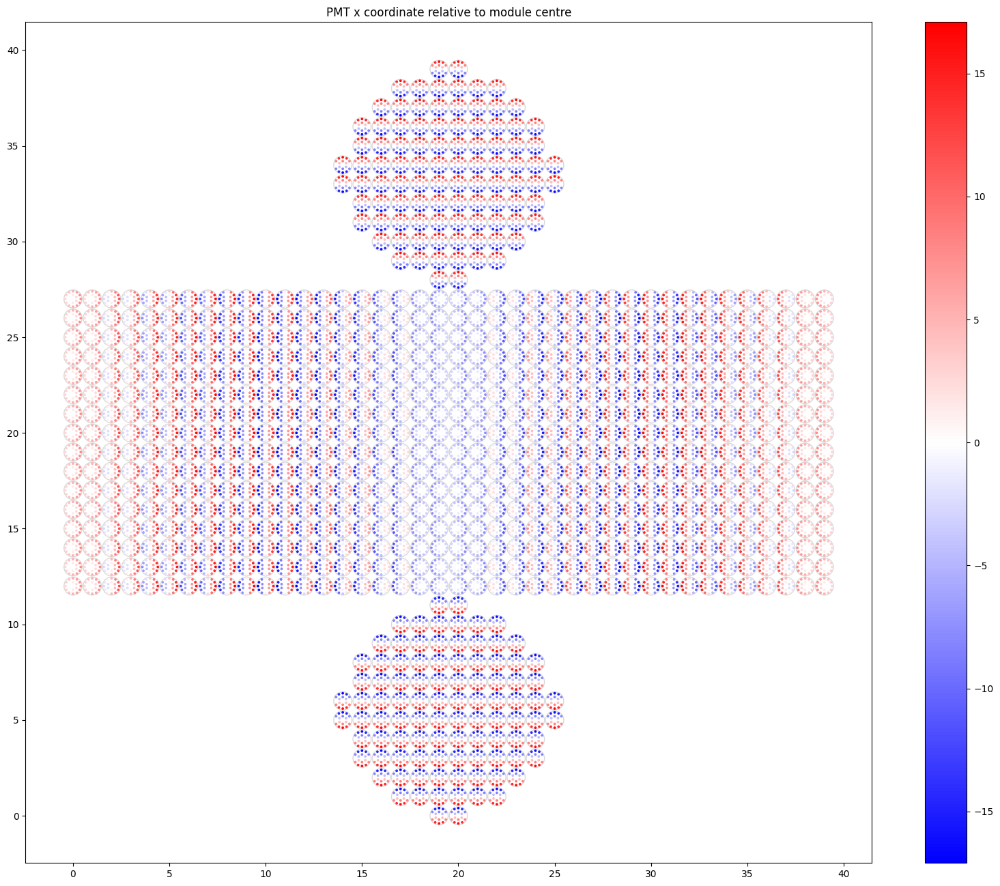

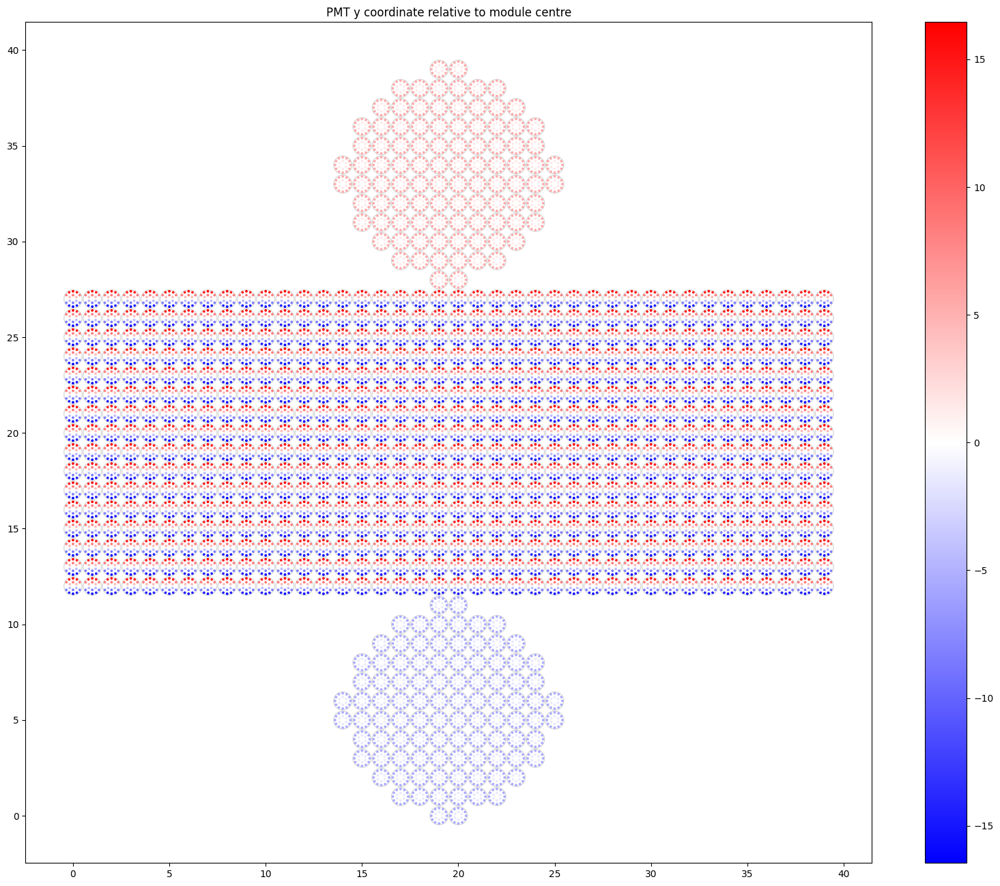

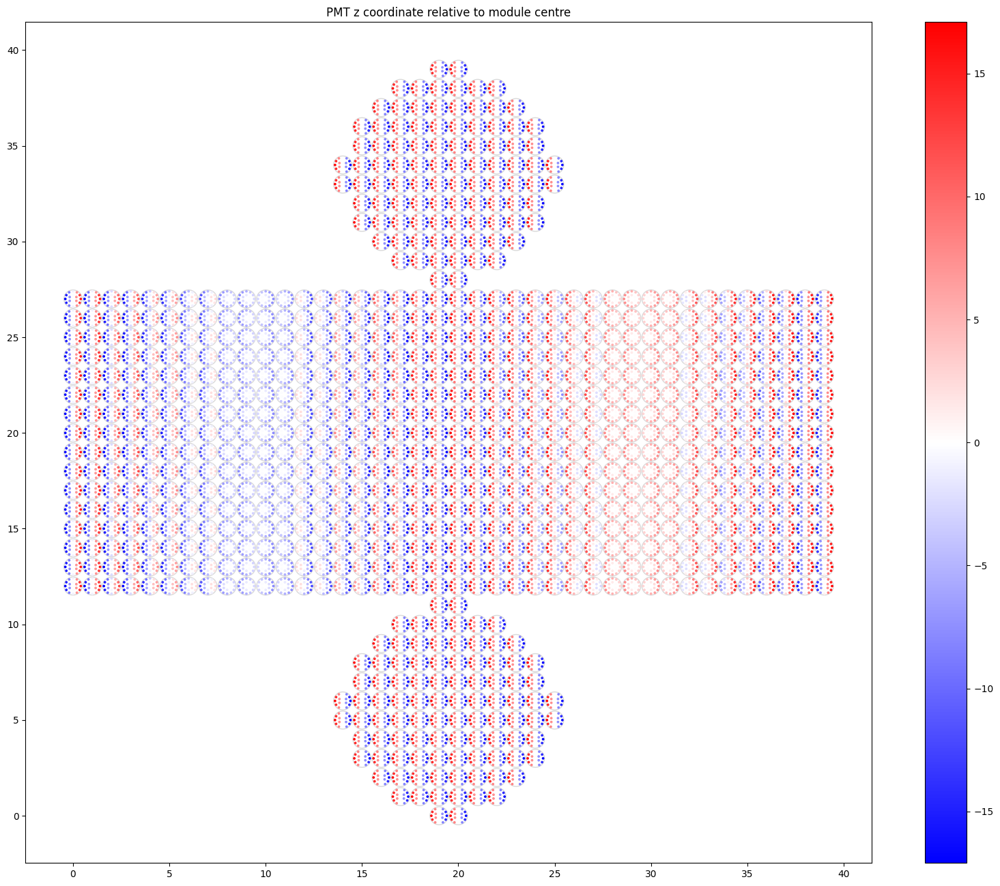

In [29]:
geo_positions_offset_long = geo_positions_long[pmt_ids_long] - geo_positions_long[(pmt_ids_long//19)*19+18]
offset_data_x_long = dataset_long.process_data(pmt_ids_long, geo_positions_offset_long[:,0])
offset_data_y_long = dataset_long.process_data(pmt_ids_long, geo_positions_offset_long[:,1])
offset_data_z_long = dataset_long.process_data(pmt_ids_long, geo_positions_offset_long[:,2])
# use color map with zero set to white so that non-physical mPMT locations don't show
plot_event(offset_data_x_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="PMT x coordinate relative to module centre")
plot_event(offset_data_y_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="PMT y coordinate relative to module centre")
plot_event(offset_data_z_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="PMT z coordinate relative to module centre")

### Test plots of x, y and z orientation values of each PMT

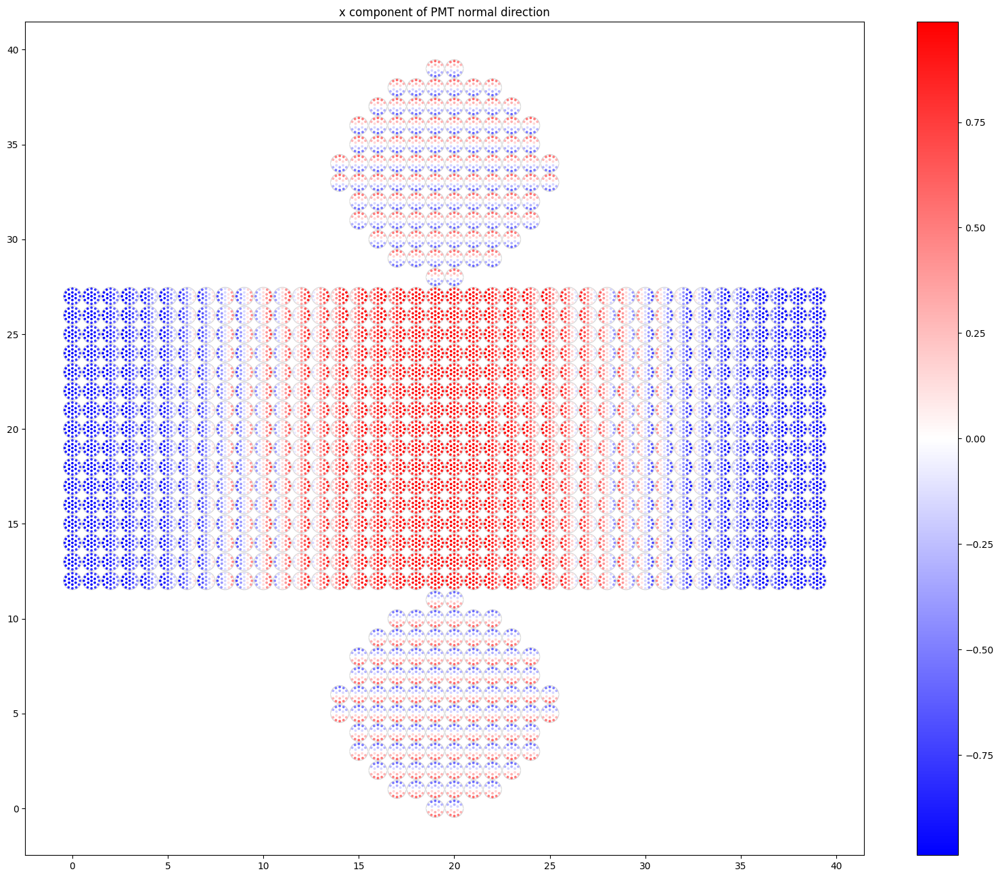

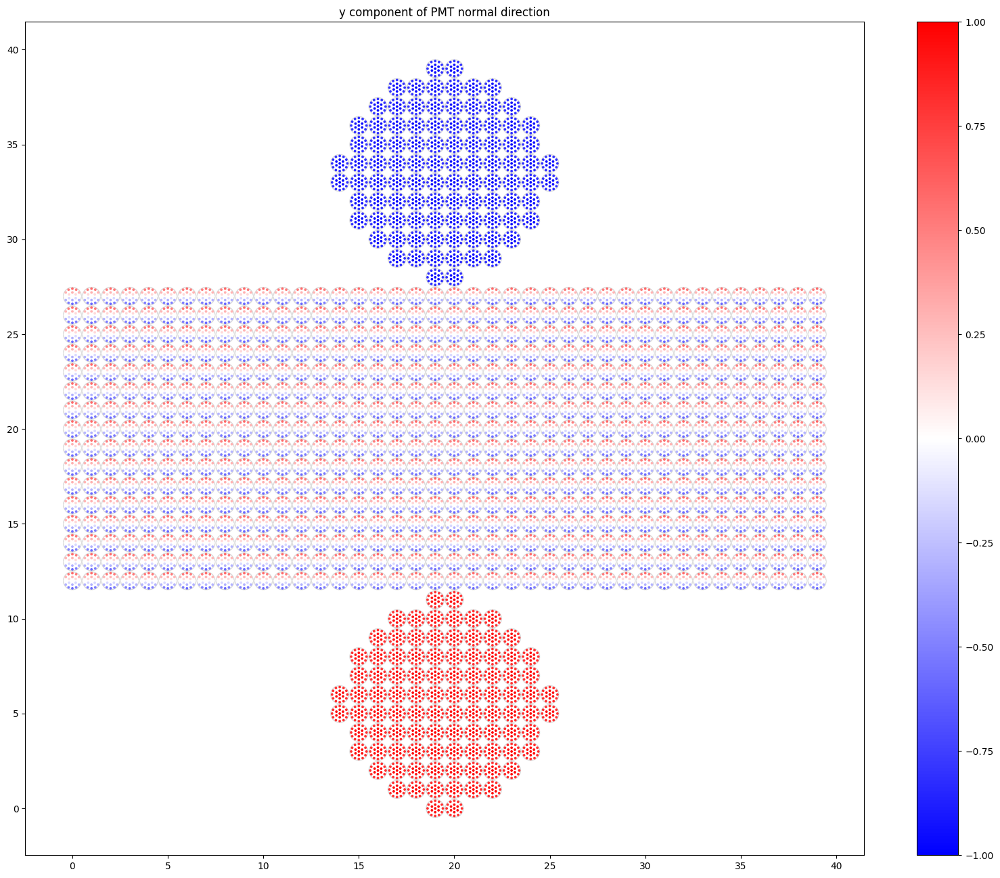

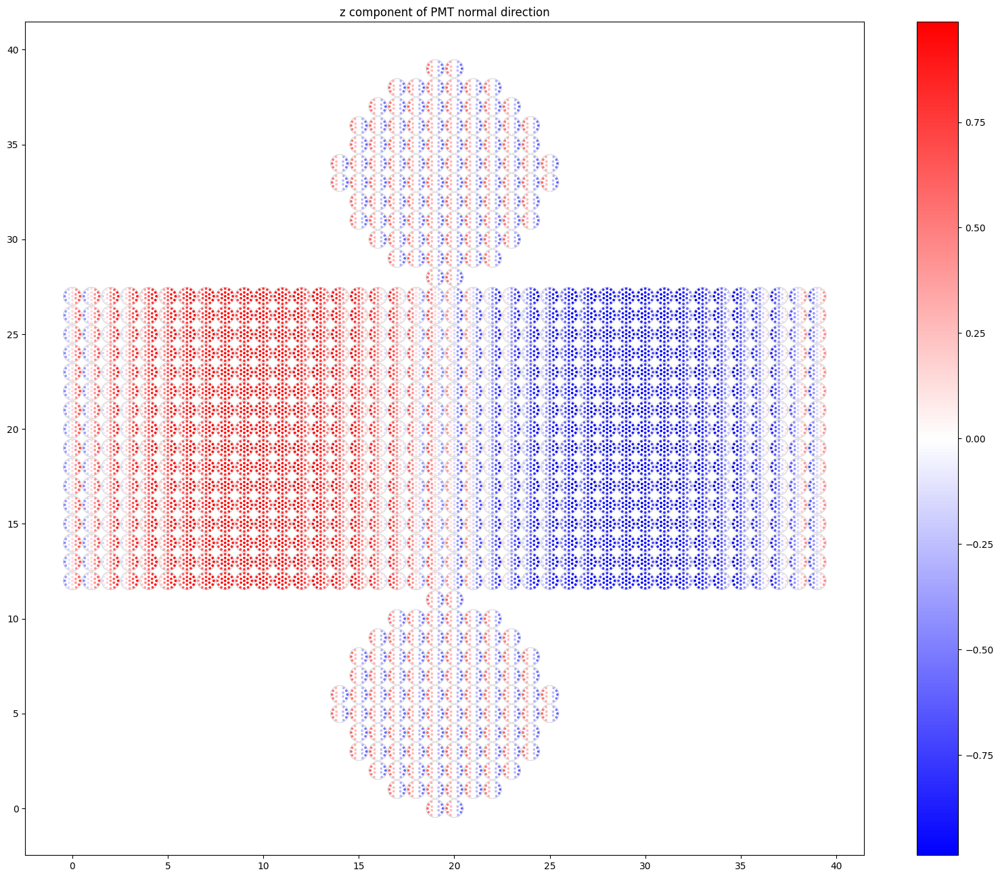

In [30]:
geo_orientations_long = geo_file_long["orientation"]
orientation_data_x_long = dataset_long.process_data(pmt_ids_long, geo_orientations_long[:,0])
orientation_data_y_long = dataset_long.process_data(pmt_ids_long, geo_orientations_long[:,1])
orientation_data_z_long = dataset_long.process_data(pmt_ids_long, geo_orientations_long[:,2])
# use color map with zero set to white so that non-physical mPMT locations don't show
plot_event(orientation_data_x_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="x component of PMT normal direction")
plot_event(orientation_data_y_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="y component of PMT normal direction")
plot_event(orientation_data_z_long, dataset_long.mpmt_positions, old_convention=True, cmap=plt.cm.bwr, title="z component of PMT normal direction")